In [1]:
pwd


u'/rri_disks/home/akacollja'

In [2]:
import sys
sys.path.append('/home/akacollja/tvb_scientific/tvb-library')
sys.path.append('/home/akacollja/tvb_scientific/tvb-data')

In [3]:
# In[3]:

import sys
nbso,nbse = sys.stdout,sys.stderr # hack part 1/2 to keep output printing properly

from tvb.simulator.lab import *
#LOG= get_logger('demo')
from tvb.simulator.plot.tools import *
import pandas as pd
import numpy as np

sys.stdout,sys.stderr = nbso,nbse  # ...hack part 2/2
#from tvb.simulator.plot.tools import plot_surface_mpl,plot_surface_mpl_mv

In [4]:
import os, sys, glob,h5py, itertools, multiprocessing
from datetime import datetime
from time import time
from scipy import optimize
from scipy.spatial import cKDTree

get_ipython().magic(u'matplotlib inline')
from matplotlib import pyplot as plt
from IPython.display import Image,display as d
import seaborn as sns

import nibabel as nib
from nilearn.plotting import plot_roi
from dipy.tracking.utils import apply_affine

In [5]:
%pylab nbagg
from tvb.simulator.lab import *
from tvb.simulator.plot.phase_plane_interactive import PhasePlaneInteractive

Populating the interactive namespace from numpy and matplotlib


/home/akacollja/miniconda/lib/python2.7/site-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['datetime', 'colors']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [5]:
%pylab nbagg
from tvb.simulator.lab import *
LOG= get_logger('demo')
from tvb.simulator.plot.tools import *

Populating the interactive namespace from numpy and matplotlib


/home/akacollja/miniconda/lib/python2.7/site-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['datetime', 'colors']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


Exploring information flow between memory and oculomotor systems

We want to look into possible pathways and their functional significance. We will start off by running a V1 stimulations to check our parameters. Once you are happy with your activation times and parameters. We will stimulation one of the hippocampal nodes and check their activation times if they ever activate. 

## Defining the stimulus 

We'll start by choosing a specific node to stimulate, in this case V1, and defining the weighting of the stimulus coming into that node. Below we'll define the temporal profile with the default Gaussian equation. 

We ran the simulation for 14000 ms and onset our stimulus at 10000ms to wait for the transient to decay.

Period ('T'): pulse repetition period is set at 5000
Tau: pulse width or pulse duration is set at 100

In [6]:
v1_node = 68
stim_name= 'V1'
#spatial pattern
weighting = numpy.zeros((154,))
weighting [[v1_node]] = 0.03

#temporal profile
eqn_t = equations.PulseTrain()
eqn_t.parameters['onset'] = 10000
eqn_t.parameters['T'] = 5000.0
eqn_t.parameters['tau'] = 100.0

We will be using a connectivity matrix that is not the default matrix and so we will need to load in this matrix. Make sure after loading it in you should name the files appropriately, zip them and then place the package in the connectivity file in tvb's data. 

In [7]:
#new_conn= connectivity.Connectivity.from_file("newconn.zip")
#new_conn.configure()
#new_conn.weights= (np.loadtxt('/home/htian/Data/avg9/weights.txt'))
#new_conn.tract_lengths= np.loadtxt('/home/htian/Data/avg9/tract_lengths.txt')

In [8]:
new_conn= connectivity.Connectivity.from_file("newconn.zip")
new_conn.configure()
new_conn.weights= (np.loadtxt('/home/akacollja/Data/avg9/weights.txt'))
new_conn.tract_lengths= np.loadtxt('/home/akacollja/Data/avg9/tract_lengths.txt')
#new_conn.tract_lengths= np.loadtxt('/home/akacollja/tract_lengths.txt')

Now, combine the spatial pattern with the temporal profile into one object. We must first configure the stimulus which happens automatically in the simulator. 

In [9]:
stimulus = patterns.StimuliRegion( temporal = eqn_t, 
                                  connectivity = new_conn, 
                                  weight = weighting)

In [10]:
stimulus.configure_space()
stimulus.configure_time(numpy.arange(0.,15000, 2**-4))

## Simulate

We must define the parameters for our simulation. Here we are using parameters that we've come up with based off of the Spiegler model and previous trials. Adjust these values to what best fits your data.

1. Coupling: The coupling function is applied to the activity propagated between regions by the "Long-range connectivity" before it enters the local dynamic equations of the Model. Its primary purpose is to 'rescale' the incoming activity to a level appropriate to Model.

2. Integrator: "A tvb.simulator.Integrator object which is an integration scheme with supporting attributes such as integration step size and noise specification for stochastic methods. It is used to compute the time courses of the model state variables.

3. Monitors: A tvb.simulator.Monitor or a list of tvb.simulator.Monitor objects that 'know' how to record relevant data from the simulation. Two main types exist: 1) simple, spatial and temporal, reductions (subsets or averages); 2) physiological measurements, such as EEG, MEG and fMRI. By default the Model's specified variables_of_interest are returned, temporally downsampled from the raw integration rate to a sample rate of 1024Hz.

In [42]:
model= models.Generic2dOscillator(d = (1/1000.) * 76.74,
                                tau =1., f= 1.,e= 0., g= -0.1, 
                            alpha =1., gamma= 1., c= 0., b= -12.3083, beta =0., a =0.)
heunint = integrators.HeunDeterministic(dt = 0.1) 
#integrators = integrators.HeunDeterministic(dt = 0.2)
#integrators = integrators.HeunStochastic(dt = 0.1, noise=noise.Additive(nsig=5e-15)) 
#integrators = integrators.HeunStochastic(dt = 0.1, noise=noise.Additive(nsig=0)) 
cpl = coupling.Linear(a=0.01198)
#cpl = coupling.Linear(a=0.01)
mons= monitors.TemporalAverage(period = 1.0)
new_conn.speed=5.0
#new_conduction.speed= conduction.speed(conduction.speed=5.0)

In [23]:
conduction_speed=new_conn.speed

## Using the Phase Plane Interactive tool to explore the model's parameters

In [25]:
PhasePlaneInteractive??

Object `PhasePlaneInteractive` not found.


<IPython.core.display.Javascript object>


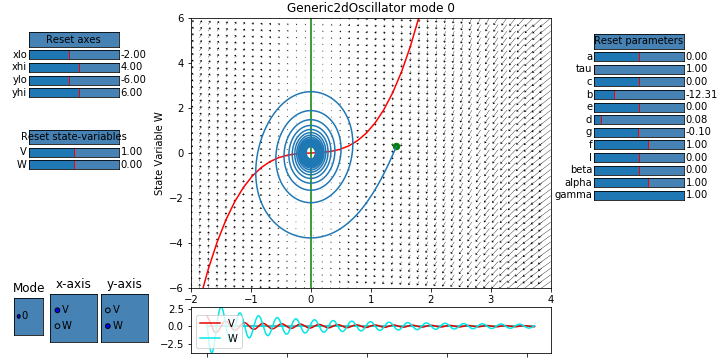

In [172]:
ppi_fig = PhasePlaneInteractive(model=model, integrator=heunint)
ppi_fig.show()

## Create and run the simulation 

1. conduction_speed: Conduction speed for "Long-range connectivity" (mm/ms)
2. stimulus: a "Spatiotemporal stimulus" can be defined at the region or surface level. It's composed of spatial and temporal components. For region defined stimuli the spatial component is just the strength with which the temporal component is applied to each region. For surface defined stimuli,  a (spatial) function, with finite-support, is used to define the strength of the stimuli on the surface centred around one or more focal points. In the current version of TVB, stimuli are applied to the first state variable of the 'Local dynamic model'.
3. initial_conditions: Initial conditions from which the simulation will begin. By default, random initial conditions are provided. Needs to be the same shape as simulator 'history', ie, initial history function which defines the minimal initial state of the network with time delays before time t=0. n_time, n_svar, n_node, n_mode <--> time points, state variables, nodes, modes
4. time points:             determined by the integration time step and simulation length
5. state-variables (sv): determined by the population model 
6. nodes:                    determined by the regions connectivity matrix
7. modes:                   determined by the population model 
8. simulation_length: The length of a simulation in milliseconds (ms).
9. connectivity: A tvb.datatypes.Connectivity object which contains the structural long-range connectivity data (i.e., white-matter tracts). In combination with the 'Long-range coupling function' it defines the inter-regional connections. These couplings undergo a time delay via signal propagation with a propagation speed of "Conduction Speed"

In [38]:
#current_state = arrays.FloatArray(required=False)

In [37]:
#import tvb.datatypes.arrays as arrays


In [22]:
#sim.current_state

In [20]:
#numpy.zeros(154)

In [21]:
#sim.state_variable_range

In [54]:
#for (i,n_time) in n_time,

#result= [n_time, n_svar, n_node, n_mode]

In [40]:
initial.shape

(106, 2, 154, 1)

In [36]:
#n_time

In [17]:
new_conn.configure()

In [14]:
init = 0.1*np.ones(sim.good_history_shape) 

In [39]:
sim = simulator.Simulator(
        model = model,
        connectivity = new_conn,
        #initial_conditions = init,
        coupling = cpl,
        integrator = heunint,
        monitors = mons,
        stimulus = stimulus, 
        simulation_length = 15000,
        #conduction_speed = 3.0
        #conduction_speed = new_conn.speed
        ).configure()


#n_time, n_svar, n_node, n_mode = sim.good_history_shape
#initial = np.empty((n_time,n_svar, n_node, n_mode)) 

#for (n_time, n_svar),

#for i in n_time:
#for n_time in range(sim.good_history_shape)
#result[0,n_time,n_svar,n_node,n_mode]= correlate()
#for i = n_time:

    #initial[0,:,:,:][0,:,0] =0.1*np.ones((154,))
    #initial[0,:,:,:][1,:,0] =0.1*np.ones((154,))
    #initial[1,:,:,:][0,:,0] =0.1*np.ones((154,))
    #initial[1,:,:,:][1,:,0] =0.1*np.ones((154,))


#sim.initial_conditions = init

new_conn.configure

sim.configure()

initial_conditions,None
coupling,"Linear(a=0.01198, b=0)"
stimulus,"StimuliRegion(bound=False, value=None)"
integrator,HeunDeterministic(dt=0.1)
surface,None
connectivity,"Connectivity(bound=False, value=None)"
conduction_speed,3.0
simulation_length,15000
model,"Generic2dOscillator(bound=False, value=None)"
monitors,"[TemporalAverage(bound=False, value=None)]"


In [16]:
#init.shape

In [17]:
#n_node

In [16]:
(tavg_time, tavg_data), = sim.run()

In [27]:


new_conn = connectivity.Connectivity(load_default=True) # (or whatever you normally put here)
new_conn.speed = 8.0
new_conn.configure()

## Visualize

Since the stimulated node's amplitude is much greater than the amplitudes of the other nodes. To be able to see the data in an appropriate scope we will exclude the stimulated node from certain calculations. Here we are inlcuding all the data except the data of the stimulated node into an array. 

In [17]:
lst_nodes = [i for i in range(154) if i != v1_node]
nostimnode=tavg_data[:, 0, lst_nodes, 0]

In the graph, the black lines will represent all nodes except the stimulated node, red is for the stimulated node, and green is for certain nodes that we want to investigate.


In [18]:
datas_raw= (nostimnode)
v1_raw= (tavg_data[:, 0, v1_node, 0])
follow_raw=( tavg_data[:, 0, 36, 0],tavg_data[:, 0, 45, 0],tavg_data[:, 0, 46, 0],tavg_data[:, 0, 47, 0],
             tavg_data[:, 0, 69, 0],tavg_data[:, 0, 70, 0],tavg_data[:, 0, 72, 0])
#follow nodes are in the order FEF, MSTd, MSTl, MT, V1, V2, V3, V4 

datas= np.squeeze(datas_raw)
v1= np.squeeze(v1_raw).T
follow = np.squeeze(follow_raw).T

<IPython.core.display.Javascript object>


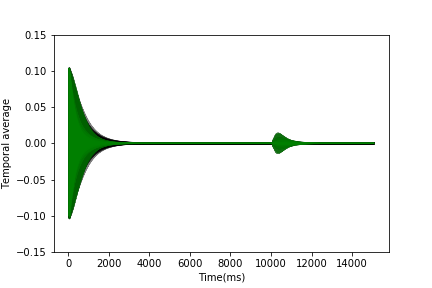

In [19]:
#time vs temporal average graph
figure()
plot(tavg_time, datas,'k', alpha = 0.5)
#plot(tavg_time, v1, 'r', alpha = 1)
plot(tavg_time, follow, 'g', alpha =0.5)
axes=plt.gca()
axes.set_ylim([-0.15, 0.15])
ylabel("Temporal average")
xlabel ("Time(ms)")
plt.grid('off')

#savefig('/home/akacollja/tvb/fig_dir/timeseries_V1', bbox_inches='tight')

# Scaled timeseries for V1

<IPython.core.display.Javascript object>


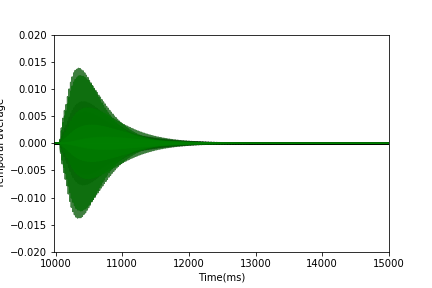

In [20]:
#time vs temporal average graph
figure()
plot(tavg_time, datas,'k', alpha = 0.5)
#plot(tavg_time, v1, 'red', alpha = 1)
plot(tavg_time, follow, 'g', alpha =0.5)
axes=plt.gca()
axes.set_xlim([9975,15000]) #([9950,10700])
axes.set_ylim([-0.02, 0.02])
ylabel("Temporal average")
xlabel ("Time(ms)")
plt.grid('off')

#savefig('/home/akacollja/tvb/fig_dir/timeseries_V1scaled', bbox_inches='tight')

#savefig('/hestia/ryan_lab/byang/Byang/deterministic/timeseries_V1scaled.png', bbox_inches='tight')
#savefig('/home/byang/fig_dir/timeseries_V1scaled', bbox_inches='tight')


# #axes.get_xlim[10000,11000]
# 
# get_xlim(10000)

## Finding thresholds

We will need to define thresholds of each invidual node. Here we are using the data 200 ms before stimlation. After finding the maximum amplitude of each node in that time period, we will make an array in the same shape as the shape of the data we are comparing it to. Next, look for when the data is greater than the maximum then when it is less than the maximum. Finally, we add them together in a single array to see when it passes threshold.

In [21]:
time_notrans = tavg_time[range(9800,15000)]
data_notrans_mean= tavg_data.squeeze().T[:,range(9800, 10000)]
data_notrans= tavg_data.squeeze().T[:,range(9800, 15000)]

data_notrans_posthr= []
data_notrans_negthr= []
data_notrans_thr= []

for node in range(len(data_notrans_mean)):
    data_notrans_posthr.append(np.array(data_notrans[node]>(data_notrans_mean[node].max())))
    data_notrans_negthr.append(np.array(data_notrans[node]<(data_notrans_mean[node].min())))
    
    data_notrans_thr.append(np.array(data_notrans_posthr[node] + data_notrans_negthr[node]))

In [22]:
data_notrans.max()

0.13401304925245133

In [23]:
data_notrans_thr

[array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ...,  True,  True,  True], dtype=bool),
 array([False, False, False, ..., 

## Finding activation times

Here we will be finding the activation times using the positive and negative thresholds. We have already compared the data with the thresholds to see what times it will surpass them. We will first find them for all nodes followed by calculating them for the specified nodes.

In [24]:
activation_time=np.array(np.zeros(len(data_notrans_thr)))
for node in range(len(data_notrans_thr)):
    for time in range(9800,15000):
        if np.array(data_notrans_thr[node][time -9800]) == True:
            activation_time[node]=time
            break
        else:
            activation_time[node]= nan
#activation_time

Compare the times to see if they match the results from the empircal data, if not change the parameters and try again.

In [25]:
#s = [113,122,123,124,145,146,147,149]
s = [36,45,46,47,68,69,70,72] 
activation_time_spec=np.array(np.zeros(len(s)))
i= 0

for node in s: 
    for time in range(9800,15000):
        if np.array(data_notrans_thr[node][time -9800]) == True:
            activation_time_spec[i]=time
            break
        else:
            activation_time_spec[i]= nan
    i += 1
activation_time_spec

array([ 10022.,  10011.,  10009.,  10007.,  10000.,  10001.,  10002.,
        10006.])

In [105]:
activation_times_spec=np.zeros(len(activation_time_spec))
for i in range(len(activation_time_spec)):
    if activation_time_spec[i] == 0 or activation_time_spec[i] < 10000:
        activation_times_spec[i]= nan
    else:
        activation_times_spec[i]= activation_time_spec[i] - 10000

In [106]:
cd '/rri_disks/home/akacollja/stim_data'

/rri_disks/home/akacollja/stim_data


In [107]:
file_name= stim_name + '_data.txt'
np.savetxt(file_name, activation_times_spec)

## Loading in region labels

Load in region labels and place them in a dataframe for easy manipulation later. 

In [30]:
rh_labs

['1_R',
 '10_R',
 '11_R',
 '12_R',
 '13_R',
 '14_R',
 '2_R',
 '23_R',
 '24_R',
 '25_R',
 '29_R',
 '30_R',
 '32_R',
 '35_R',
 '36_R',
 '3a_R',
 '3b_R',
 '4_R',
 '45_R',
 '46_R',
 '5_R',
 '6_R',
 '7a_R',
 '7b_R',
 '9_R',
 'A1_R',
 'AITd_R',
 'AITv_R',
 'A2_R',
 'CA1_R',
 'CA3_R',
 'CITd_R',
 'CITv_R',
 'CM_R',
 'DP_R',
 'ER_R',
 'FEF_R',
 'FST_R',
 'G_R',
 'Id_R',
 'Ig_R',
 'L_R',
 'LIP_R',
 'MDP_R',
 'MIP_R',
 'MSTd_R',
 'MSTl_R',
 'MT_R',
 'PA_R',
 'PAC_R',
 'PaS_R',
 'PIP_R',
 'PIR_R',
 'PITd_R',
 'PITv_R',
 'PO_R',
 'Pro_R',
 'PrS_R',
 'PSd_R',
 'Ri_R',
 'RL_R',
 'S_R',
 'SII_R',
 'SMA_R',
 'STPa_R',
 'STPp_R',
 'TF_R',
 'TH_R',
 'V1_R',
 'V2_R',
 'V3_R',
 'V3A_R',
 'V4_R',
 'V4t_R',
 'VIP_R',
 'VOT_R',
 'VP_R']

In [27]:
import pandas as pd
pd.set_option('display.max_rows',200)
df_tavg = pd.DataFrame(np.squeeze(tavg_data),index=tavg_time)

labs= pd.read_csv('/home/htian/Data/kelly_matrix/labelnames.txt',sep='\t')['acronym'].values

lh_labs = [l + '_L' for l in labs]
rh_labs = [l + '_R' for l in labs]
region_labels_lr = np.concatenate([lh_labs, rh_labs])

df_tavg_labs = df_tavg.copy()
df_tavg_labs.columns= region_labels_lr


In [23]:
df_tavg

,0,1,2,3,4,5,6,7,8,9,...,144,145,146,147,148,149,150,151,152,153
0.5,9.229857e-02,9.232922e-02,9.224802e-02,9.221557e-02,9.228222e-02,9.228561e-02,9.231833e-02,9.233072e-02,0.092486,9.218933e-02,...,9.219631e-02,9.224990e-02,9.253317e-02,9.225052e-02,9.223387e-02,9.241838e-02,9.217507e-02,9.214255e-02,9.222481e-02,9.222195e-02
1.5,1.026744e-01,1.027716e-01,1.025142e-01,1.024114e-01,1.026225e-01,1.026334e-01,1.027370e-01,1.027766e-01,0.103267,1.023285e-01,...,1.023503e-01,1.025207e-01,1.034171e-01,1.025225e-01,1.024696e-01,1.030533e-01,1.022835e-01,1.021802e-01,1.024404e-01,1.024324e-01
2.5,9.566576e-02,9.582017e-02,9.541182e-02,9.524886e-02,9.558328e-02,9.560098e-02,9.576510e-02,9.582846e-02,0.096607,9.511787e-02,...,9.515154e-02,9.542303e-02,9.684249e-02,9.542566e-02,9.534156e-02,9.626521e-02,9.504673e-02,9.488259e-02,9.529430e-02,9.528347e-02
3.5,8.180186e-02,8.199529e-02,8.148439e-02,8.128070e-02,8.169849e-02,8.172112e-02,8.192613e-02,8.200637e-02,0.082981,8.111750e-02,...,8.115859e-02,8.149970e-02,8.327199e-02,8.150263e-02,8.139715e-02,8.254957e-02,8.102892e-02,8.082312e-02,8.133677e-02,8.132582e-02
4.5,6.209521e-02,6.230257e-02,6.175569e-02,6.153794e-02,6.198433e-02,6.200917e-02,6.222820e-02,6.231537e-02,0.063358,6.136409e-02,...,6.140679e-02,6.177365e-02,6.366621e-02,6.177636e-02,6.166313e-02,6.289268e-02,6.126980e-02,6.104901e-02,6.159695e-02,6.158846e-02
5.5,3.796772e-02,3.815961e-02,3.765462e-02,3.745392e-02,3.786508e-02,3.788875e-02,3.809048e-02,3.817269e-02,0.039135,3.729440e-02,...,3.733231e-02,3.767308e-02,3.941524e-02,3.767506e-02,3.757014e-02,3.870057e-02,3.720797e-02,3.700352e-02,3.750717e-02,3.750320e-02
6.5,1.115304e-02,1.129884e-02,1.091662e-02,1.076526e-02,1.107505e-02,1.109388e-02,1.124587e-02,1.131051e-02,0.012038,1.064580e-02,...,1.067262e-02,1.093290e-02,1.224472e-02,1.093377e-02,1.085392e-02,1.170317e-02,1.058116e-02,1.042580e-02,1.080399e-02,1.080575e-02
7.5,-1.642138e-02,-1.635009e-02,-1.653460e-02,-1.660677e-02,-1.645942e-02,-1.644901e-02,-1.637671e-02,-1.634160e-02,-0.015992,-1.666261e-02,...,-1.665229e-02,-1.652344e-02,-1.590005e-02,-1.652391e-02,-1.656306e-02,-1.616257e-02,-1.669267e-02,-1.676847e-02,-1.659041e-02,-1.658271e-02
8.5,-4.276841e-02,-4.279450e-02,-4.272124e-02,-4.269037e-02,-4.275417e-02,-4.275524e-02,-4.278652e-02,-4.279084e-02,-0.042935,-4.266396e-02,...,-4.267409e-02,-4.271808e-02,-4.298850e-02,-4.271992e-02,-4.270574e-02,-4.288710e-02,-4.264939e-02,-4.262099e-02,-4.270237e-02,-4.268959e-02
9.5,-6.598511e-02,-6.612285e-02,-6.575456e-02,-6.560594e-02,-6.591083e-02,-6.592552e-02,-6.607505e-02,-6.612535e-02,-0.066833,-6.548607e-02,...,-6.551856e-02,-6.576183e-02,-6.705168e-02,-6.576489e-02,-6.568941e-02,-6.653364e-02,-6.542083e-02,-6.527276e-02,-6.564963e-02,-6.563360e-02


## Bar Graphs

We'll be graphing a bunch of bar graphs for visualization purposes.

#### activation times of all nodes

To display the activation times we will want to start displaying the time of the stimulation as 0. To do this we will need to loop through the activation times and subtract 10000 from each value. If the value is already less than 10000 we will replace it with nan since it does not activate.

In [24]:
activation_times=np.zeros(len(activation_time))

for i in range(len(activation_time)):
    if activation_time[i] == 0 or activation_time[i] < 10000:
        activation_times[i]= nan
    else:
        activation_times[i]= activation_time[i] - 10000

Since our data doesn't include the stimulated node, we will need to remove that label from our labels. 

In [25]:
lst_nodes = [i for i in range(154) if i != v1_node]
labels_nostim=region_labels_lr[lst_nodes]

Now, just load the labels and activation times into a dataframe. Then, sort the activation times in ascending order. Finally, plot the ordered activation times.

In [26]:
df_activation= pd.DataFrame(activation_times, region_labels_lr) 

df_activation_sort = df_activation.sort_values(0)

<IPython.core.display.Javascript object>


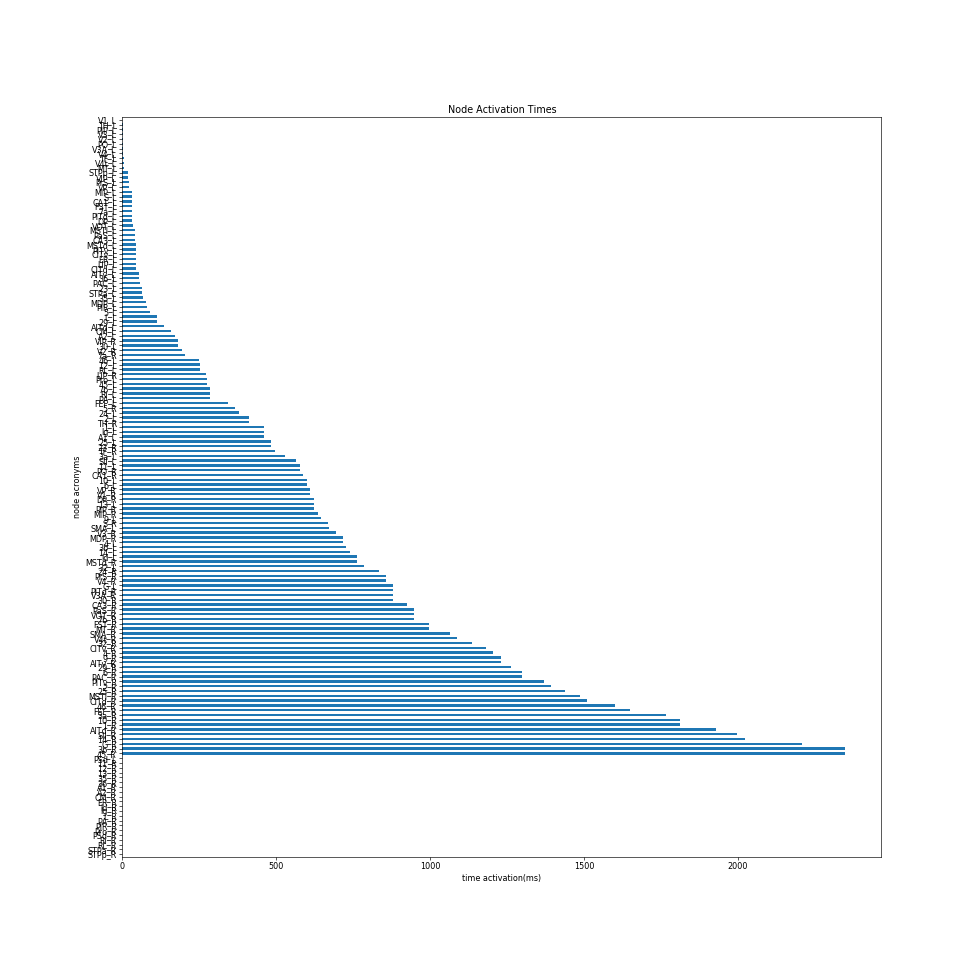

In [27]:
ax = df_activation_sort.plot(kind='barh', title="distances", figsize=(17,17), legend=False)
y_pos = np.arange(len(df_activation_sort))
width= 0.35
rects = ax.barh(y_pos, df_activation_sort, width)

ax.set_ylabel('node acronyms')
ax.set_xlabel('time activation(ms)')
ax.invert_yaxis()
ax.set_title('Node Activation Times')

#### activation times of specific nodes

Now repeat the same process for your specified nodes

In [28]:
activation_times_spec=np.zeros(len(activation_time_spec))

for i in range(len(activation_time_spec)):
    if activation_time_spec[i] == 0 or activation_time_spec[i] < 10000:
        activation_times_spec[i]= 0
    else:
        activation_times_spec[i]= activation_time_spec[i] - 10000

Here, you will need to manually include your label names in the same order as before or feel free to write a loop to include the labels that you want. 

In [29]:
lab_spec= np.array(['FEF_L', 'MST(45)', 'MST(46)', 'MT_L', 'V1_L', 'V2_L', 'V3_L', 'V4_L'])

In [30]:
df_activation_spec= pd.DataFrame(activation_times_spec, lab_spec) 

df_activation_spec_sort = df_activation_spec.sort_values(0)

<IPython.core.display.Javascript object>


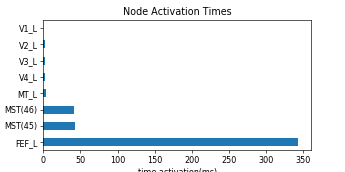

In [31]:
ax = df_activation_spec_sort.plot(kind='barh', title="distances", figsize=(6,3), legend=False)
y_pos = np.arange(len(df_activation_spec_sort))
width= 0.05
rects = ax.barh(y_pos, df_activation_spec_sort, width)

ax.set_ylabel('node acronyms')
ax.set_xlabel('time activation(ms)')
ax.invert_yaxis()
ax.set_title('Node Activation Times')

#### distances

We'll be making a bar graph to display the distances in order of closest to farthest nodes from our stimulated node (V1 for this case).

In [32]:
i =v1_node
distances= np.array(np.zeros(len(new_conn.tract_lengths)))

for j in range(len(new_conn.tract_lengths)):
    distances[j]= new_conn.tract_lengths[i, j]

Here we will need to slice the distances array at 77 because we only care about the distances of the nodes in the left hemisphere. Load them into a dataframe then sort. Then, plot. 

In [33]:
df_distances= pd.DataFrame([labs, distances[:77]]).T

df_distances_labs= df_distances.sort_values(0)

<IPython.core.display.Javascript object>


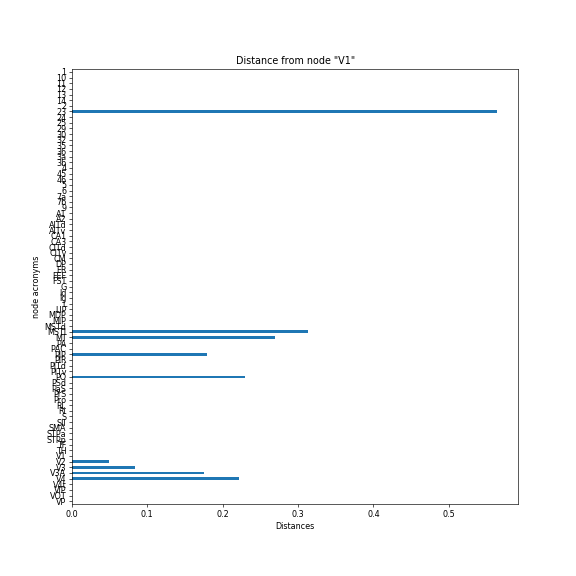

In [34]:
ax = df_distances_labs.plot(kind='barh', title="distances", figsize=(10,10), legend=False)

y_pos = np.arange(len(distances[:77]))
width= 0.35
rects = ax.barh(y_pos,df_distances_labs[1], width)
ax.set_ylabel('node acronyms')
ax.set_xlabel('Distances')
ax.set_title('Distance from node "V1"')
ax.invert_yaxis()

ax.set_yticks(range(len(labs)))
ytickNames = ax.set_yticklabels(df_distances_labs[0])

## Finding amplitudes of each node

To find the amplitudes we will need to loop through the data (excluding the stimulated node) and make an array of each node's max

In [28]:
#no stim node in this data set
max_amp= []
for node in range(len(nostimnode.T)):
    max_amp.append(max(abs(nostimnode.T[node, :])))

In [29]:
df_max_amp= pd.DataFrame(max_amp, labels_nostim) 

df_max_amp_sort= df_max_amp.sort_values(0)

<IPython.core.display.Javascript object>


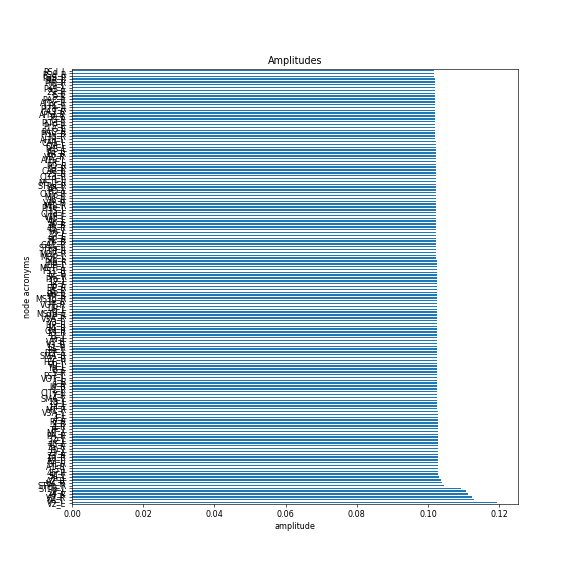

In [30]:
ax = df_max_amp_sort.plot(kind='barh', title="amplitudes", figsize=(10,10), legend=False)
y_pos = np.arange(len(df_max_amp_sort))
width= 0.35
rects = ax.barh(y_pos, df_max_amp_sort, width)

ax.set_ylabel('node acronyms')
ax.set_xlabel('amplitude')
ax.invert_yaxis()
ax.set_title('Amplitudes')

## Heat Map

As another way to visualize the dissipation of the stimulus is to use a heatmap. It is important to adjust vmin and vmax accordingly.  

<IPython.core.display.Javascript object>


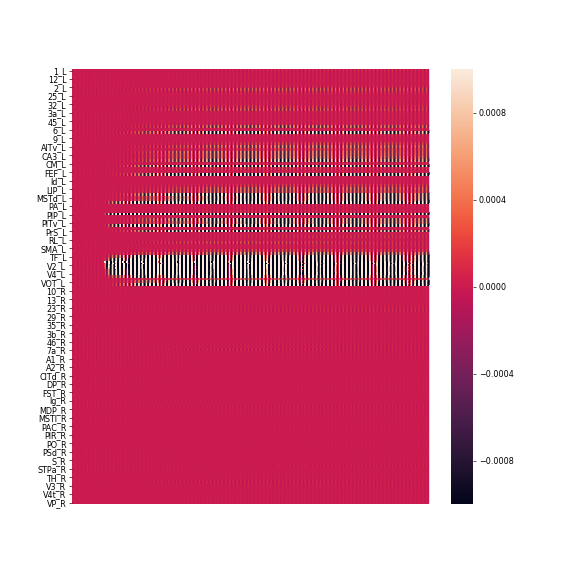

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  after removing the cwd from sys.path.
/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  """


In [38]:
import seaborn as sns

fig, ax = plt.subplots(figsize = (10, 10))
sns.heatmap(df_tavg_labs.ix[9800:12000].T, ax=ax, vmin=-0.001, vmax=0.001, xticklabels='')
ax.imshow(df_tavg.ix[9800:12000].T.values,vmin=-0.001, vmax=0.001, aspect='auto',cmap='coolwarm',
          interpolation='none')
ax.set_yticklabels
ax.grid('off')
for label in ax.get_yticklabels(): label.set_rotation(0)

## Covariance matrix

We will need to calculate the covariance values 200ms before the stimulationand plot them on a matrix

<IPython.core.display.Javascript object>


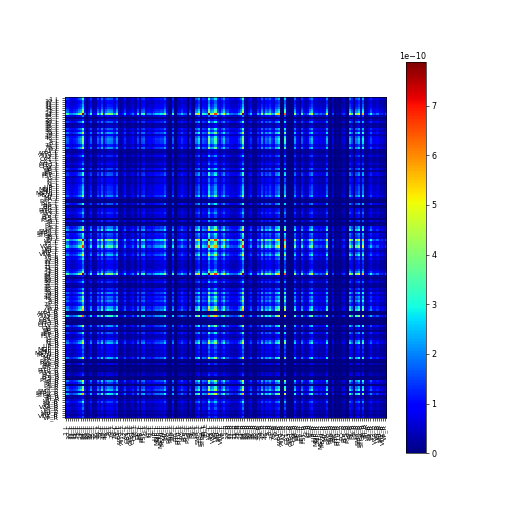

In [39]:
dat_notrans_prestim= np.squeeze(nostimnode.T)[:,range(9800, 10000)]
dat_notrans_cov = np.cov(dat_notrans_prestim)

fig, ax= plt.subplots(figsize= (9,9))
fig.canvas.draw()
ax.set_xticks(range(len(labels_nostim)))
ax.set_yticks(range(len(labels_nostim)))
ax.set_xticklabels(labels_nostim,rotation=90,fontsize=8)
ax.set_yticklabels(labels_nostim, fontsize=8)
plt.imshow(dat_notrans_cov, cmap= 'jet')
plt.grid('off')
plt.colorbar()

#### Eigenvector matrix

Calculate the Eigen vector matrix from covariance matrix and plot

<IPython.core.display.Javascript object>


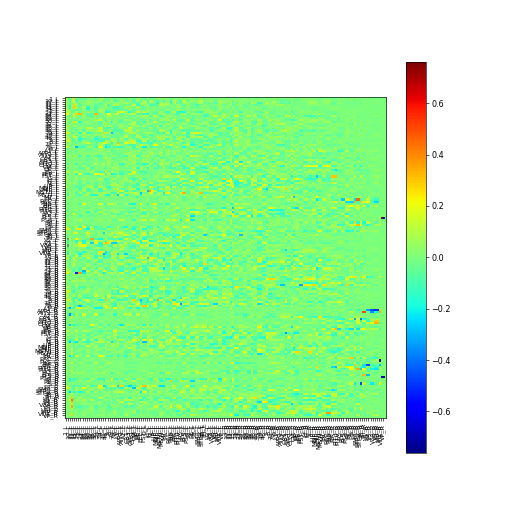

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:13: ComplexWarning: Casting complex values to real discards the imaginary part
  del sys.path[0]


In [40]:
from scipy.linalg import eig

dat_notrans_cov_evals, dat_notrans_cov_evecs = np.linalg.eig(dat_notrans_cov)

fig, ax =plt.subplots(figsize= (9,9))
fig.canvas.draw()
ax.set_xticks(range(len(labels_nostim)))
ax.set_yticks(range(len(labels_nostim)))
ax.set_xticklabels(labels_nostim,rotation=90,fontsize=8)
ax.set_yticklabels(labels_nostim, fontsize= 8)

dat_notrans_cov_evecs_154 = np.zeros([154,154])
dat_notrans_cov_evecs_154[:153,:153] = dat_notrans_cov_evecs
plt.imshow(dat_notrans_cov_evecs_154, cmap= 'jet')
plt.grid('off')
plt.colorbar()

---


Later, our data will require a null entry so we will create a version of our eigenvector matrix that has 155 nodes as the last one will be for the null entry. 

In [41]:
dat_notrans_cov_evecs_155 = np.zeros([155,155])
dat_notrans_cov_evecs_155[:153,:153] = dat_notrans_cov_evecs

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:2: ComplexWarning: Casting complex values to real discards the imaginary part
  


## Time Slice on Brain Surface

To follow the dissipation visually, we will be plotting the data on a brain surface.

In [17]:
from tvb.datatypes.cortex import Cortex
from tvb.datatypes.region_mapping import RegionMapping
from tvb.datatypes.projections import ProjectionMatrix
import pandas as pd
from matplotlib.tri import Triangulation
from numpy import pi, cos, sin
from matplotlib import cm

In [18]:
def plot_surface_mpl(vtx,tri,data=None,rm=None,reorient=None,view='superior',
                     shaded=False,ax=None,figsize=(6,4), title=None,
                     lthr=None,uthr=None, nz_thr = 1E-20,
                     shade_kwargs = {'edgecolors': 'k', 'linewidth': 0.1,
                                     'alpha': None, 'cmap': 'coolwarm',
                                     'vmin': None, 'vmax': None}):

    # in the namespace inadvertently. 
    vtx,tri = vtx.copy(),tri.copy()
    if data is not None: data = data.copy()

    # 1. Set the viewing angle 
  
    if reorient == 'tvb':
        # The tvb default brain has coordinates in the order 
        # yxz for some reason. So first change that:   
        vtx = np.array([vtx[:,1],vtx[:,0],vtx[:,2]]).T.copy()
        # Also need to reflect in the x axis
        vtx[:,0]*=-1

    # (reorient == 'fs' is same as reorient=None; so not strictly needed
    #  but is included for clarity)

    # ...get rotations for standard view options
    
    if   view == 'lh_lat'    : rots =  [(0,-90),(1,90)  ]
    elif view == 'lh_med'    : rots =  [(0,-90),(1,-90) ] 
    elif view == 'rh_lat'    : rots =  [(0,-90),(1,-90) ]
    elif view == 'rh_med'    : rots =  [(0,-90),(1,90)  ]
    elif view == 'superior'  : rots =   None
    elif view == 'inferior'  : rots =   (1,180)
    elif view == 'anterior'  : rots =   (0,-90)
    elif view == 'posterior' : rots =  [(0, -90),(1,180)]
    elif (type(view) == tuple) or (type(view) == list): rots = view 

    # (rh_lat is the default 'view' argument because no rotations are 
    #  for that one; so if no view is specified when the function is called, 
    #  the 'rh_lat' option is chose here and the surface is shown 'as is'                          
                            
    # ...apply rotations                          
    if rots is None: rotmat = np.eye(3)
    else:            rotmat = get_combined_rotation_matrix(rots)
    vtx = np.dot(vtx,rotmat)

    # 2. Sort out the data
                                    
    # ...if no data is given, plot a vector of 1s. 
    #    if using region data, create corresponding surface vector 
    if data is None: 
        data = np.ones(vtx.shape[0]) 
    elif data.shape[0] != vtx.shape[0]: 
        data = np.array([data[r] for r in rm])
    
    # ...apply thresholds
    if uthr: data *= (data < uthr)
    if lthr: data *= (data > lthr)
    data *= (np.abs(data) > nz_thr)

    # 3. Create the surface triangulation object 
    x,y,z = vtx.T
    tx,ty,tz = vtx[tri].mean(axis=1).T
    tr = Triangulation(x,y,tri[np.argsort(tz)])
                
    # 4. Make the figure 
    if ax is None: fig, ax = plt.subplots(figsize=figsize)  
  
    #if shade = 'gouraud': shade_opts['shade'] = 
    tc = ax.tripcolor(tr, np.squeeze(data), **shade_kwargs)
                        
    ax.set_aspect('equal')
    ax.axis('off')
    
    if title is not None: ax.set_title(title)


In [19]:
def plot_surface_mpl_mv(vtx=None,tri=None,data=None,rm=None,hemi=None,   # Option 1
                        vtx_lh=None,tri_lh=None,data_lh=None,rm_lh=None, # Option 2
                        vtx_rh=None,tri_rh=None,data_rh=None,rm_rh=None,
                        title=None,**kwargs):
 
    if vtx is not None:                                    # Option 1
        tri_hemi = hemi[tri].any(axis=1)
        tri_lh,tri_rh = tri[tri_hemi==0],tri[tri_hemi==1]
    elif vtx_lh is not None:                               # Option 2
        vtx = np.vstack([vtx_lh,vtx_rh])
        tri = np.vstack([tri_lh,tri_rh+tri_lh.max()+1])

    if data_lh is not None:                                # Option 2
        data = np.hstack([data_lh,data_rh])
    
    if rm_lh is not None:                                  # Option 2 
        rm = np.hstack([rm_lh,rm_rh + rm_lh.max() + 1])
    
 
    # 2. Now do the plots for each view

    # (Note: for the single hemispheres we only need lh/rh arrays for the 
    #  faces (tri); the full vertices, region mapping, and data arrays
    #  can be given as arguments, they just won't be shown if they aren't 
    #  connected by the faces in tri )
  
    # LH lateral
    plot_surface_mpl(vtx,tri_lh,data=data,rm=rm,view='lh_lat',
                   ax=subplot(2,3,1),**kwargs)
    
    # LH medial
    plot_surface_mpl(vtx,tri_lh, data=data,rm=rm,view='lh_med',
                   ax=subplot(2,3,4),**kwargs)
    
    # RH lateral
    plot_surface_mpl(vtx,tri_rh, data=data,rm=rm,view='rh_lat',
                   ax=subplot(2,3,3),**kwargs)
    
    # RH medial
    plot_surface_mpl(vtx,tri_rh, data=data,rm=rm,view='rh_med',
                   ax=subplot(2,3,6),**kwargs)
    
    # Both superior
    plot_surface_mpl(vtx,tri, data=data,rm=rm,view='superior',
                   ax=subplot(1,3,2),title=title,**kwargs)
    
    plt.subplots_adjust(left=0.0, right=1.0, bottom=0.0,
                      top=1.0, wspace=0, hspace=0) 
    

In [20]:
def get_combined_rotation_matrix(rotations):
    rotmat = np.eye(3)
    
    if type(rotations) is tuple: rotations = [rotations] 
    for r in rotations:
        newrot = get_rotation_matrix(r[0],r[1])
        rotmat = np.dot(rotmat,newrot)
    return rotmat

In [21]:
def get_rotation_matrix(rotation_axis, deg):
    # (note make deg minus to change from anticlockwise to clockwise rotation)
    th = -deg * (pi/180) # convert degrees to radians
    
    if rotation_axis == 0:
        return np.array( [[    1,         0,         0    ],
                          [    0,      cos(th),   -sin(th)],
                          [    0,      sin(th),    cos(th)]])
    elif rotation_axis ==1:
        return np.array( [[   cos(th),    0,        sin(th)],
                          [    0,         1,          0    ],
                          [  -sin(th),    0,        cos(th)]])
    elif rotation_axis ==2:
        return np.array([[   cos(th),  -sin(th),     0    ],
                         [    sin(th),   cos(th),     0   ],
                         [     0,         0,          1   ]])

We willl now need to load in the region mapping files to help us create the plotting surface. Here, we have appended the path where our files are located. Our region mapping file works when manually loaded in so that is what we will do for our file but feel free to attach the zip file name instead. 

In [22]:
ctx_file ='/home/htian/Data/newzip.zip'
rm= np.loadtxt('/home/htian/Data/region_mapping.txt').astype(int)
hemi= np.loadtxt('/home/htian/Data/fv91_srfData_20170215/hemispheres.txt').astype(int)

In [23]:
ctx = cortex.Cortex.from_file(source_file = ctx_file)
vtx,tri = ctx.vertices,ctx.triangles
df_tavg = pd.DataFrame(np.squeeze(tavg_data),index=tavg_time)
df_tavg

,0,1,2,3,4,5,6,7,8,9,...,144,145,146,147,148,149,150,151,152,153
0.5,9.229857e-02,9.232922e-02,9.224802e-02,9.221557e-02,9.228222e-02,9.228561e-02,9.231833e-02,9.233072e-02,0.092486,9.218933e-02,...,9.219631e-02,9.224990e-02,9.253317e-02,9.225052e-02,9.223387e-02,9.241838e-02,9.217507e-02,9.214255e-02,9.222481e-02,9.222195e-02
1.5,1.026744e-01,1.027716e-01,1.025142e-01,1.024114e-01,1.026225e-01,1.026334e-01,1.027370e-01,1.027766e-01,0.103267,1.023285e-01,...,1.023503e-01,1.025207e-01,1.034171e-01,1.025225e-01,1.024696e-01,1.030533e-01,1.022835e-01,1.021802e-01,1.024404e-01,1.024324e-01
2.5,9.566576e-02,9.582017e-02,9.541182e-02,9.524886e-02,9.558328e-02,9.560098e-02,9.576510e-02,9.582846e-02,0.096607,9.511787e-02,...,9.515154e-02,9.542303e-02,9.684249e-02,9.542566e-02,9.534156e-02,9.626521e-02,9.504673e-02,9.488259e-02,9.529430e-02,9.528347e-02
3.5,8.180186e-02,8.199529e-02,8.148439e-02,8.128070e-02,8.169849e-02,8.172112e-02,8.192613e-02,8.200637e-02,0.082981,8.111750e-02,...,8.115859e-02,8.149970e-02,8.327199e-02,8.150263e-02,8.139715e-02,8.254957e-02,8.102892e-02,8.082312e-02,8.133677e-02,8.132582e-02
4.5,6.209521e-02,6.230257e-02,6.175569e-02,6.153794e-02,6.198433e-02,6.200917e-02,6.222820e-02,6.231537e-02,0.063358,6.136409e-02,...,6.140679e-02,6.177365e-02,6.366621e-02,6.177636e-02,6.166313e-02,6.289268e-02,6.126980e-02,6.104901e-02,6.159695e-02,6.158846e-02
5.5,3.796772e-02,3.815961e-02,3.765462e-02,3.745392e-02,3.786508e-02,3.788875e-02,3.809048e-02,3.817269e-02,0.039135,3.729440e-02,...,3.733231e-02,3.767308e-02,3.941524e-02,3.767506e-02,3.757014e-02,3.870057e-02,3.720797e-02,3.700352e-02,3.750717e-02,3.750320e-02
6.5,1.115304e-02,1.129884e-02,1.091662e-02,1.076526e-02,1.107505e-02,1.109388e-02,1.124587e-02,1.131051e-02,0.012038,1.064580e-02,...,1.067262e-02,1.093290e-02,1.224472e-02,1.093377e-02,1.085392e-02,1.170317e-02,1.058116e-02,1.042580e-02,1.080399e-02,1.080575e-02
7.5,-1.642138e-02,-1.635009e-02,-1.653460e-02,-1.660677e-02,-1.645942e-02,-1.644901e-02,-1.637671e-02,-1.634160e-02,-0.015992,-1.666261e-02,...,-1.665229e-02,-1.652344e-02,-1.590005e-02,-1.652391e-02,-1.656306e-02,-1.616257e-02,-1.669267e-02,-1.676847e-02,-1.659041e-02,-1.658271e-02
8.5,-4.276841e-02,-4.279450e-02,-4.272124e-02,-4.269037e-02,-4.275417e-02,-4.275524e-02,-4.278652e-02,-4.279084e-02,-0.042935,-4.266396e-02,...,-4.267409e-02,-4.271808e-02,-4.298850e-02,-4.271992e-02,-4.270574e-02,-4.288710e-02,-4.264939e-02,-4.262099e-02,-4.270237e-02,-4.268959e-02
9.5,-6.598511e-02,-6.612285e-02,-6.575456e-02,-6.560594e-02,-6.591083e-02,-6.592552e-02,-6.607505e-02,-6.612535e-02,-0.066833,-6.548607e-02,...,-6.551856e-02,-6.576183e-02,-6.705168e-02,-6.576489e-02,-6.568941e-02,-6.653364e-02,-6.542083e-02,-6.527276e-02,-6.564963e-02,-6.563360e-02


In [38]:
rm.shape

(70078,)

We're going to normalize all values at their respective time. We will set the stimulated node to 0 because we only care about the amplitudes of all other nodes and we don't want it to be taken as the maximum.

In [24]:
notstim= np.squeeze(tavg_data).copy()
notstim[:, 68]= 0
m = np.array([(np.abs(notstim[i])).max() for i in range(len(notstim))])
for i in range(len(notstim)):
    for j in range(len(notstim[1])):
        print i,
        notstim[i,j] /= m[i]
        
df_notstim = pd.DataFrame(notstim,index=tavg_time)

0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 5

 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 67 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 68 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 69 

 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 

112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 114 

130 130 130 130 130 130 130 130 130 130 130 130 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 

 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 149 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150 150

 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 166 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167 167

 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 185 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186 186

 202 202 202 202 202 202 202 202 202 202 202 202 202 202 202 202 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 203 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204 204

220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 221 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 

237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 237 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 238 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 239 

256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 256 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 

 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277

293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 

 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311

 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 327 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328

344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 344 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 345 

 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 362 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 363 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364 364

379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 379 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 380 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 381 

 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 398 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 399 400 400 400 400 400 400 400 400 400 400 400 400 400 400 400 400

415 415 415 415 415 415 415 415 415 415 415 415 415 415 415 415 415 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 416 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 417 

 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 431 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 432 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433 433

 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 451 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452 452

470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 470 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 471 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 472 

 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 490 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491

509 509 509 509 509 509 509 509 509 509 509 509 509 509 509 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 510 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 511 

528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 528 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 529 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 530 

 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 547 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 548 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549 549

565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 565 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 566 

 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 584 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585 585

603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 603 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 604 605 605 605 605 605 605 605 605 605 605 605 605 605 605 605 

 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 622 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623

639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 

657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 

678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 678 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 679 

 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 694 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695

711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 711 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 712 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 713 

 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 730 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732

 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 747 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 748 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749

765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 765 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 766 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 

786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 787 

 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 801 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 803 803 803 803 803 803 803 803

 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821

 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 837 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839

855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 857 

 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 869 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870 870

886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 886 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 887 

904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 904 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 905 

 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 922 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923 923

939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 939 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 940 

 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 954 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955 955

972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 972 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 973 

989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 989 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 990 

1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1006 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 1007 

 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1024 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025 1025

 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1041 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042 1042

 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1057 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058 1058

1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1073 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1074 1075 1075 1075 1075 1075 1075 1075 1075 1075 

1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1090 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 1091 

 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1105 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1106 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107 1107

1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1122 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 1123 

1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 

 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1158 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159 1159

1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1175 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 1176 

 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1192 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193 1193

 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1206 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207 1207

 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1219 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220 1220

1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1233 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 1234 

 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1246 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247 1247

 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1260 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261 1261

 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1273 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274 1274

1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1291 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1292 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 1293 

 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1310 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311 1311

1326 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1327 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 1328 

1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 

1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1355 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1356 1357 

1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1372 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 1373 

 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1389 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1390 1391 1391 1391 1391 1391 1391 1391 1391 1391 1391 1391 1391 1391 1391 1391

1407 1407 1407 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1408 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 1409 

1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1425 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 1426 

1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1444 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 1445 

1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1463 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 1464 

 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1479 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1480 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481 1481

1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1496 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1497 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 1498 

 1515 1515 1515 1515 1515 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1516 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517 1517

 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1534 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535 1535

1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1548 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 

1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1560 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 1561 

 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1576 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1577 1578 1578 1578 1578 1578 1578 1578 1578 1578 1578 1578

1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1593 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1594 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 1595 

 1612 1612 1612 1612 1612 1612 1612 1612 1612 1612 1612 1612 1612 1612 1612 1612 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1613 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614 1614

 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1629 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1630 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631 1631

 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1649 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650

 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1667 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669

 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687 1687

1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 

 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1723 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724 1724

 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1740 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1741 1742 1742

1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1759 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 1760 

1777 1777 1777 1777 1777 1777 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 

 1794 1794 1794 1794 1794 1794 1794 1794 1794 1794 1794 1794 1794 1794 1794 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1795 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796

1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1811 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 1812 

 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1829 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1830 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831

1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1847 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 

1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 

1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1883 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 

1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1901 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 

 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920

1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1937 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 

 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955

1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 

1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1989 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 

 2007 2007 2007 2007 2007 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2008 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009 2009

2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 2026 

2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2041 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 

 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2060 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061

2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2077 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 

 2094 2094 2094 2094 2094 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2095 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096 2096

 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2112 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113 2113

2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2131 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2132 2133 2133 2133 2133 2133 2133 2133 2133 

2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2148 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2149 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 2150 

2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2167 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 2168 

2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2185 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2186 2187 2187 

2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2203 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 

 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2218 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219 2219

2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2235 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 2236 

2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2251 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 2252 

 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2269 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270 2270

2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2287 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 2288 

 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2304 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305 2305

2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2321 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 2322 

 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2340 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341

 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2358 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359 2359

2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2375 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 2376 

2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2391 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 2392 

 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2405 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406 2406

 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2420 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421 2421

2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2437 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 2438 

 2455 2455 2455 2455 2455 2455 2455 2455 2455 2455 2455 2455 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2456 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457 2457

2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2473 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 2474 

2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2492 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 

2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2512 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 2513 

 2529 2529 2529 2529 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2530 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531 2531

2547 2547 2547 2547 2547 2547 2547 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 

2565 2565 2565 2565 2565 2565 2565 2565 2565 2565 2565 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2566 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 2567 

2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2583 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 2584 

2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2599 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 2600 

2617 2617 2617 2617 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2618 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 2619 

 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2636 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637 2637

2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2651 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2652 2653 2653 2653 2653 2653 2653 2653 2653 

 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2670 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2671 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672 2672

 2689 2689 2689 2689 2689 2689 2689 2689 2689 2689 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2690 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691 2691

2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2707 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 2708 

2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2725 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2726 2727 2727 2727 2727 2727 2727 2727 2727 2727 2727 2727 2727 

 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2745 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746 2746

2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2763 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 2764 

2781 2781 2781 2781 2781 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2782 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 2783 

 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2800 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2801 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802 2802

2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2819 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2820 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 2821 

2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2837 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 2838 

 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2856 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857 2857

 2875 2875 2875 2875 2875 2875 2875 2875 2875 2875 2875 2875 2875 2875 2875 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2876 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877 2877

 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2895 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896 2896

 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2906 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907 2907

 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2925 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926 2926

2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2944 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 2945 

 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2963 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964 2964

2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2982 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 2983 

 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 2999 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000 3000

3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3017 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 

 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036

 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3053 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054 3054

 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3069 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070 3070

3086 3086 3086 3086 3086 3086 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3087 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 3088 

 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3106 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107 3107

 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3126 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127 3127

3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3145 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 3146 

3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3165 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 3166 

3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 

 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3204 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205 3205

3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3223 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 3224 

3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3242 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3243 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 3244 

 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3261 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3262 3263 3263 3263 3263 3263 3263 3263

3278 3278 3278 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3279 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 3280 

 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3297 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298 3298

 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3314 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315 3315

 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3329 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330 3330

3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3340 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3341 3342 3342 3342 3342 3342 3342 

3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3353 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 3354 

 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3372 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373 3373

 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3391 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3392 3393 3393 3393 3393 3393

 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3408 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409 3409

3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3420 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 3421 

 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3436 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437 3437

 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451

3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3465 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3466 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 

 3476 3476 3476 3476 3476 3476 3476 3476 3476 3476 3476 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3477 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478 3478

 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3495 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3496 3497 3497 3497 3497 3497 3497

 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3515 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516 3516

 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3532 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533 3533

3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3545 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 3546 

 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3557 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558 3558

3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3576 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3577 3578 

3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3595 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3596 3597 3597 3597 

3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3614 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 3615 

 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3631 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3632 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633 3633

3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3650 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 3651 

 3667 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3668 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669 3669

3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3686 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 3687 

 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3697 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698 3698

 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3710 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711 3711

 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3723 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724 3724

3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3735 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 3736 

 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3747 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748 3748

 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3759 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760 3760

3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3771 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 3772 

3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 

 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3797 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798 3798

3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3809 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 3810 

3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 3823 

 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3835 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3836 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837 3837

3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3849 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 3850 

3864 3864 3864 3864 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3865 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 3866 

3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3878 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 3879 

3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3895 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 3896 

 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3914 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915 3915

 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3928 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929 3929

 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941

3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3954 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 3955 

3971 3971 3971 3971 3971 3971 3971 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3972 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 3973 

3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3989 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3990 3991 3991 3991 3991 3991 3991 3991 3991 3991 3991 3991 3991 3991 3991 

4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4008 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 

 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4025 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026 4026

 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4041 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042 4042

4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4060 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 4061 

 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4076 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4077 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078 4078

4091 4091 4091 4091 4091 4091 4091 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4092 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 4093 

 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4107 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4108 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109 4109

4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4124 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4125 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 4126 

 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4143 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144 4144

4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4160 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 4161 

4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4177 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 4178 

4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4195 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4196 4197 4197 4197 4197 4197 4197 4197 4197 

 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4211 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213

 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230

 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248

 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266

4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4284 4285 4285 4285 4285 4285 4285 4285 4285 4285 4285 4285 4285 4285 4285 4285 

4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 

 4317 4317 4317 4317 4317 4317 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319

4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 

4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4355 4356 4356 4356 4356 4356 4356 4356 4356 4356 

 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4372 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373 4373

 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4390 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391 4391

4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4405 4406 4406 4406 4406 4406 

 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423 4423

 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440

4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 

 4472 4472 4472 4472 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4473 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474 4474

 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4491 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492 4492

 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4508 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509 4509

 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4525 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526 4526

4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4543 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 4544 

4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4560 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 4561 

 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4578 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4579 4580 4580 4580 4580 4580 4580

4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4596 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 4597 

4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4612 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 4613 

4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4630 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 4631 

 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4648 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649

4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4665 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 4666 

4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4682 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 4683 

4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 4700 

 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4717 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718 4718

 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4733 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4734 4735 4735 4735 4735 4735 4735 4735 4735 4735 4735 4735 4735 4735 4735 4735

4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4748 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4749 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 4750 

4765 4765 4765 4765 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4766 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 4767 

 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4783 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784 4784

 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4799 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800 4800

4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4812 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 4813 

 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4829 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830 4830

 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4846 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847 4847

 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4863 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864 4864

 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4879 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4880 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881 4881

 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4894 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895 4895

 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4913 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914 4914

 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4930 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931 4931

 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4948 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949 4949

 4965 4965 4965 4965 4965 4965 4965 4965 4965 4965 4965 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4966 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967 4967

4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 

5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5002 5003 5003 5003 5003 5003 5003 5003 5003 5003 5003 5003 5003 5003 5003 5003 

 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5020 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021 5021

5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5038 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 5039 

5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5055 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5056 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 5057 

 5072 5072 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5073 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074 5074

5091 5091 5091 5091 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5092 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 5093 

 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5109 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110 5110

5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5127 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 5128 

 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5144 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145 5145

5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5163 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 5164 

5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5181 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 5182 

5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5199 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 5200 

5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5218 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 5219 

5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5237 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 5238 

5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5254 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 

 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273

 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5290 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291 5291

 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5309 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310 5310

 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5326 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5327 5328 5328 5328 5328 5328

 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5344 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5345 5346 5346 5346 5346 5346 5346 5346 5346 5346 5346 5346 5346 5346 5346

5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5362 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 5363 

 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5381 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382 5382

5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5397 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 5398 

 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5415 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5416 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417 5417

5432 5432 5432 5432 5432 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5433 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 5434 

 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5451 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5452 5453 5453 5453 5453 5453 5453 5453 5453 5453 5453 5453 5453

5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5468 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 5469 

 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5485 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486 5486

5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5504 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 5505 

 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5519 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5520 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521 5521

 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5536 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5537 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538 5538

5555 5555 5555 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5556 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 5557 

5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5573 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 5574 

 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5591 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592 5592

 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5609 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610 5610

 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5627 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628 5628

5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5645 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 

 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664

5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 5682 

 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5699 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700 5700

 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5718 5719 5719 5719 5719 5719 5719

5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5735 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 5736 

5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5753 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 5754 

5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5770 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 5771 

 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5786 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787 5787

 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5805 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806 5806

5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5819 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 5820 

 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5836 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837 5837

5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5850 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 5851 

 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5867 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868 5868

 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5886 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887 5887

 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5903 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5904 5905 5905 5905 5905 5905 5905 5905 5905 5905 5905 5905 5905 5905 5905

 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5920 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921 5921

 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5939 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940 5940

5956 5956 5956 5956 5956 5956 5956 5956 5956 5956 5956 5956 5956 5956 5956 5956 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5957 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 5958 

 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5974 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5975 5976 5976 5976 5976 5976 5976

5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5990 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5991 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 5992 

6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6007 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 6008 

 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024

 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043 6043

6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 

6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 6079 

6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 

 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115

6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6130 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 6131 

 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6147 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148 6148

 6164 6164 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6165 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166 6166

6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 

 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6192 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193 6193

6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6206 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 6207 

6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6224 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 6225 

6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6241 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 6242 

 6259 6259 6259 6259 6259 6259 6259 6259 6259 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6260 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261 6261

 6276 6276 6276 6276 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6277 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278 6278

6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6296 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 6297 

6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6312 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 6313 

6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6329 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 6330 

6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6346 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 6347 

6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6364 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 

6380 6380 6380 6380 6380 6380 6380 6380 6380 6380 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6381 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 6382 

 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6399 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400 6400

 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6413 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6414 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415 6415

6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6426 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 6427 

 6438 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6439 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440 6440

6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6452 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 6453 

 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6470 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471 6471

6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6483 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 6484 

 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6494 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495

 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6511 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6512 6513 6513 6513 6513 6513 6513 6513

 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6524 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525 6525

6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6537 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 6538 

6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 6550 

 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6562 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563 6563

 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6573 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574 6574

6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6588 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 6589 

 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6604 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605

6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6623 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 

 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6640 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641 6641

 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6659 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660

 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679

6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 

 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715 6715

 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6731 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6732 6733 6733 6733 6733 6733 6733 6733 6733 6733 6733 6733 6733 6733 6733 6733

 6747 6747 6747 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749

 6766 6766 6766 6766 6766 6766 6766 6766 6766 6766 6766 6766 6766 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768

 6785 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6786 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787 6787

 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6803 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804 6804

 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6822 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823 6823

 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6838 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839 6839

 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6856 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857 6857

6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6873 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 6874 

 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6890 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891 6891

6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6909 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 6910 

 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6925 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6926 6927 6927 6927

6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6941 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 6942 

 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6953 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954 6954

 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6967 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968 6968

 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6978 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979 6979

 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6990 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6991 6992 6992 6992

7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7005 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 7006 

7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7020 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 7021 

7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7036 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 7037 

 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7053 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054 7054

 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7071 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7072 7073 7073 7073 7073 7073 7073 7073 7073 7073 7073 7073 7073 7073 7073 7073 7073

 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7087 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088 7088

7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7103 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7104 7105 7105 7105 7105 7105 7105 7105 7105 7105 

 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7119 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120 7120

7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7130 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 7131 

7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7142 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 7143 

7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7154 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 7155 

7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7166 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 7167 

 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7181 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182 7182

7194 7194 7194 7194 7194 7194 7194 7194 7194 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7195 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 7196 

 7210 7210 7210 7210 7210 7210 7210 7210 7210 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7211 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212 7212

 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224 7224

 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7239 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241

 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7254 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255 7255

 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7272 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7273 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274

 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7285 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7286 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287 7287

 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7299 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300 7300

7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7314 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 7315 

 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7328 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7329 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330 7330

 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7344 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345 7345

7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7360 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 7361 

7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7376 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 7377 

7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 

 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7407 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408 7408

 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7421 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422 7422

 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7432 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433 7433

7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7444 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7445 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 7446 

7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7457 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 7458 

7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7474 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 7475 

7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7492 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7493 7494 7494 7494 7494 7494 7494 7494 7494 7494 7494 7494 7494 7494 7494 

7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7510 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 7511 

 7526 7526 7526 7526 7526 7526 7526 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7527 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528 7528

7545 7545 7545 7545 7545 7545 7545 7545 7545 7545 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7546 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 7547 

 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7565 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566 7566

 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7584 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585 7585

 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7597 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598 7598

 7614 7614 7614 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7615 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616 7616

 7633 7633 7633 7633 7633 7633 7633 7633 7633 7633 7633 7633 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7634 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635 7635

7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7652 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7653 7654 7654 

 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7672 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673 7673

 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7689 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690 7690

 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7708 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709 7709

7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7727 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 

7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7746 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 

7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7763 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 

 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784

7801 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 7803 

7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 

 7837 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7838 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839 7839

 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7856 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7857 7858 7858 7858 7858 7858

 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7876 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877 7877

 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7893 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894 7894

 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7912 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913 7913

 7928 7928 7928 7928 7928 7928 7928 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7929 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930 7930

 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7944 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945 7945

7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7961 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 7962 

 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7979 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980 7980

 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7996 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7997 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998 7998

8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8013 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 8014 

8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8029 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 8030 

 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8045 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046 8046

8061 8061 8061 8061 8061 8061 8061 8061 8061 8061 8061 8061 8061 8061 8061 8061 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8062 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 8063 

 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8078 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079 8079

 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098 8098

8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 

 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8132 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133 8133

 8148 8148 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8149 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150 8150

8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8165 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8166 8167 8167 8167 

8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8183 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 8184 

8199 8199 8199 8199 8199 8199 8199 8199 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8200 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 8201 

8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8217 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 8218 

8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 8235 

8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8252 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 8253 

 8269 8269 8269 8269 8269 8269 8269 8269 8269 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8270 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271 8271

8285 8285 8285 8285 8285 8285 8285 8285 8285 8285 8285 8285 8285 8285 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8286 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 

8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8303 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8304 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 

8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8322 8322 8322 8322 8322 8322 8322 8322 8322 8322 8322 8322 8322 8322 8322 8322 

8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 

8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 

 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8370 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372

 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8388 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389

8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 

 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8422 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423 8423

 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8442 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443

 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8460 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461

8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 

 8495 8495 8495 8495 8495 8495 8495 8495 8495 8495 8495 8495 8495 8495 8495 8495 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8496 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497

 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8512 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513 8513

8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8531 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8532 8533 8533 8533 8533 8533 

8548 8548 8548 8548 8548 8548 8548 8548 8548 8548 8548 8548 8548 8548 8548 8548 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8549 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 8550 

8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8567 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 8568 

8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8583 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8584 8585 8585 8585 8585 8585 8585 8585 8585 8585 8585 8585 8585 8585 8585 

 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8600 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8601 8602 8602 8602 8602 8602 8602 8602 8602 8602 8602 8602 8602 8602 8602 8602 8602

 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8619 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620 8620

 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8636 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8637 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638 8638

 8655 8655 8655 8655 8655 8655 8655 8655 8655 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657

 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8675 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676 8676

8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8693 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 8694 

 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8711 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712 8712

8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8730 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 8731 

 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8749 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750 8750

8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8766 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 8767 

8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 

8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 8805 

8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 

 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8840 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841 8841

8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8857 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8858 8859 8859 8859 8859 8859 8859 8859 8859 8859 8859 8859 

8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8876 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 8877 

 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8889 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890

8907 8907 8907 8907 8907 8907 8907 8907 8907 8907 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8908 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 

 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8925 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926

 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8943 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8944 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945

 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8960 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961 8961

 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8977 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978 8978

8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8995 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 8996 

 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9012 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013 9013

 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9029 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030 9030

 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9045 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046 9046

 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9060 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061 9061

9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9074 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 9075 

9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9089 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9090 9091 9091 9091 9091 9091 9091 9091 9091 9091 

9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9107 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 9108 

 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9126 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127 9127

 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9144 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9145 9146 9146 9146 9146 9146 9146 9146 9146 9146 9146 9146

 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9162 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163 9163

 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9181 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182 9182

9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9199 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 9200 

9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9217 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 9218 

9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9233 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9234 9235 9235 9235 9235 9235 9235 9235 

9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9250 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 9251 

9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9266 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 9267 

9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9284 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9285 9286 9286 9286 9286 

9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9302 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 9303 

9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9320 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 9321 

9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9338 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9339 9340 9340 9340 9340 

9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9353 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9354 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 9355 

9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9372 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9373 9374 9374 9374 9374 9374 9374 9374 9374 9374 9374 9374 9374 9374 9374 

9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9392 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 9393 

 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9409 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410 9410

 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9428 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429

9446 9446 9446 9446 9446 9446 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 9448 

9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9464 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 

 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9483 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485

 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503 9503

 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9521 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9522 9523 9523 9523 9523 9523 9523 9523 9523

9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9538 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9539 9540 9540 9540 9540 9540 9540 9540 9540 9540 9540 9540 9540 9540 

 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9557 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558 9558

 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9574 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575 9575

9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9593 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 9594 

 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9610 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611 9611

9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9629 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 9630 

 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9645 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9646 9647 9647 9647 9647 9647 9647 9647 9647 9647 9647 9647 9647 9647 9647 9647

 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9664 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665 9665

 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9681 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682 9682

 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9700 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701 9701

 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9720 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721 9721

9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9738 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 9739 

9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9756 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 9757 

 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774 9774

9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 9792 

 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9808 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809 9809

9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 9828 

 9845 9845 9845 9845 9845 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9846 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847 9847

9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9863 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 9864 

 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9881 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9882 9883 9883 9883 9883 9883 9883 9883 9883 9883

9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9899 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 9900 

9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9918 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 9919 

9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9936 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9937 9938 9938 9938 9938 

 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9954 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955 9955

9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9973 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 9974 

 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9992 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993 9993

 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10009 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 10010 100

10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10025 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 10026 1002

 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10034 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 10035 100

 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10043 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 10044 100

 10060 10060 10060 10060 10060 10060 10060 10060 10060 10060 10060 10060 10060 10060 10060 10060 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 10061 100

 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10070 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 10071 100

10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10080 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 10081 1008

10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10089 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 10090 1009

 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10099 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 10100 101

 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10108 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 10109 101

10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10126 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 10127 1012

10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10135 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 10136 1013

10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10144 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 10145 1014

 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10162 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 10163 101

 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10171 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 10172 101

10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10180 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 10181 1018

10197 10197 10197 10197 10197 10197 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10198 10199 10199 10199 10199 10199 10199 1019

10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10207 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 10208 1020

10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10223 10224 10224 10224 10224 10224 10224 10224 10224 10224 10224 10224 10224 10224 10224 1022

 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10239 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 10240 102

10248 10248 10248 10248 10248 10248 10248 10248 10248 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10249 10250 10250 10250 1025

10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10258 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 10259 1025

 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10273 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 10274 102

10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 1028

 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10298 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 10299 102

10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10308 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 10309 1030

 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10318 10319 10319 10319 10319 10319 10319 10319 10319 10319 10319 10319 10319 10319 103

10326 10326 10326 10326 10326 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10327 10328 10328 10328 10328 10328 10328 10328 1032

10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 10337 1033

 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10345 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 10346 103

 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10363 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 10364 103

10372 10372 10372 10372 10372 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10373 10374 10374 10374 10374 10374 10374 10374 1037

10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10382 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 10383 1038

 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10391 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 10392 103

10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10400 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 10401 1040

 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10417 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 10418 104

 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10427 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 10428 104

 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10436 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 10437 104

10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10454 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 10455 1045

 10463 10463 10463 10463 10463 10463 10463 10463 10463 10463 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10464 10465 10465 104

 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10473 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 10474 104

 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10483 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 10484 104

 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10493 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 10494 104

10502 10502 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10503 10504 10504 10504 10504 10504 10504 10504 10504 10504 10504 1050

 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10512 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 105

 10521 10521 10521 10521 10521 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10523 10523 10523 10523 10523 10523 10523 105

10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10538 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 10539 1053

10547 10547 10547 10547 10547 10547 10547 10547 10547 10547 10547 10547 10547 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 10548 1054

 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10557 10558 10558 10558 10558 10558 10558 10558 10558 10558 10558 10558 10558 10558 10558 10558 105

10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 1057

 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 10585 105

 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10593 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 10594 105

 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10603 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 10604 106

10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10613 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 10614 1061

10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10622 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 10623 1062

10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10632 10633 10633 10633 10633 10633 10633 10633 10633 10633 10633 10633 10633 10633 10633 1063

 10641 10641 10641 10641 10641 10641 10641 10641 10641 10641 10641 10641 10641 10641 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 10642 106

10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10652 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 10653 1065

 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10667 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 10668 106

10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10677 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 1067

 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10686 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 10687 106

 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10696 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 10697 106

 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10707 10707 10707 10707 10707 10707 10707 10707 10707 10707 10707 10707 10707 10707 107

10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 1072

10741 10741 10741 10741 10741 10741 10741 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10742 10743 10743 10743 10743 10743 1074

 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10758 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 10759 107

 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10767 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 10768 107

10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10784 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 10785 1078

 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10793 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 10794 107

 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10810 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 10811 108

 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 108

 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10830 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 10831 108

10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10846 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 10847 1084

10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10856 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 10857 1085

 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10870 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 10871 108

10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 1088

10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10894 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 10895 1089

10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10904 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 10905 1090

10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10921 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 10922 1092

 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10930 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 10931 109

10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10947 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 10948 1094

10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10957 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 10958 1095

10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10966 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 10967 1096

 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10982 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 10983 109

 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10998 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 10999 109

 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11010 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 11011 110

11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11024 11025 11025 11025 11025 11025 11025 11025 11025 11025 11025 11025 11025 11025 11025 11025 1102

11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11033 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 11034 1103

11047 11047 11047 11047 11047 11047 11047 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11048 11049 11049 11049 11049 11049 1104

 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11060 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 110

11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11069 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 11070 1107

 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 110

 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 11098 110

11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 1110

 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11115 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 11116 111

11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 1113

 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11147 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 11148 111

11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11164 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 11165 1116

 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11174 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 11175 111

 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11183 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 11184 111

 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 112

 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11209 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 11210 112

 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11226 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 11227 112

 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11235 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 11236 112

 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11244 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 11245 112

11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11261 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 11262 1126

11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11278 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 11279 1127

11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11287 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 11288 1128

11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11304 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 11305 1130

11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11313 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 11314 1131

11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11322 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 11323 1132

 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11339 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 11340 113

11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11356 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 11357 1135

 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11365 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 11366 113

 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11374 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 113

11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11391 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 11392 1139

11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11401 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 11402 1140

 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11410 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 11411 114

 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 114

11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11437 11438 11438 11438 11438 11438 11438 11438 11438 11438 11438 11438 11438 11438 11438 1143

11445 11445 11445 11445 11445 11445 11445 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11446 11447 11447 11447 11447 11447 1144

11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11463 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 11464 1146

 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11472 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 11473 114

11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11482 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 11483 1148

11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11491 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 1149

11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11508 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 11509 1150

 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11517 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 11518 115

 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 115

11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11544 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 11545 1154

 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11554 11555 11555 11555 11555 11555 11555 11555 11555 11555 11555 11555 11555 11555 115

 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11563 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 11564 115

 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 115

 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11582 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 11583 115

 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11599 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 11600 116

 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11608 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 11609 116

11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 1162

11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 11641 1164

11657 11657 11657 11657 11657 11657 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11658 11659 11659 11659 11659 11659 11659 1165

11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11667 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 11668 1166

11676 11676 11676 11676 11676 11676 11676 11676 11676 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11677 11678 11678 11678 1167

11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11694 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 11695 1169

 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11703 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 11704 117

11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11712 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 11713 1171

11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11730 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 11731 1173

11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 11744 1174

 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11755 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 11756 117

 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11765 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 11766 117

11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11780 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 11781 1178

11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11790 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 11791 1179

 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11807 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 11808 118

 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11816 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 11817 118

11825 11825 11825 11825 11825 11825 11825 11825 11825 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11826 11827 11827 11827 1182

 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11842 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 11843 118

11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11852 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 11853 1185

11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11869 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 11870 1187

11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11878 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 11879 1187

11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 11889 1188

11896 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11897 11898 11898 11898 11898 11898 11898 11898 11898 11898 11898 11898 1189

 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11914 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 11915 119

 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11923 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 11924 119

 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11940 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 11941 119

 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11950 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 11951 119

 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11959 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 11960 119

11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11968 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 11969 1196

 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11986 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 11987 119

11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 1199

12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12014 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 1201

12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12031 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 12032 1203

 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12040 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 120

12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12050 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 1205

 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12062 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 12063 120

 12072 12072 12072 12072 12072 12072 12072 12072 12072 12072 12072 12072 12072 12072 12072 12072 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 12073 120

 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12082 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 12083 120

12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12091 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 12092 1209

 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12109 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 12110 121

12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12118 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 12119 1211

12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12127 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 12128 1212

12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12142 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 12143 1214

12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12151 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 12152 1215

12160 12160 12160 12160 12160 12160 12160 12160 12160 12160 12160 12160 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 12161 1216

 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12177 12178 12178 12178 12178 12178 12178 12178 12178 12178 12178 12178 12178 12178 121

 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 121

 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12207 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 12208 122

 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12222 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 12223 122

 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12232 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 12233 122

12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12242 12243 12243 12243 12243 12243 12243 12243 12243 12243 12243 12243 12243 12243 12243 12243 1224

 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12251 12252 12252 12252 12252 12252 12252 12252 12252 12252 12252 12252 12252 12252 12252 122

12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12268 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 12269 1226

 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12284 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 12285 122

 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12294 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 12295 122

12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12303 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 12304 1230

12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12312 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 12313 1231

 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12329 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 12330 123

 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12339 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 12340 123

 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12348 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 12349 123

 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12364 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 12365 123

 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12381 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 12382 123

 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12391 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 12392 123

12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12406 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 12407 1240

12423 12423 12423 12423 12423 12423 12423 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12424 12425 12425 12425 12425 12425 1242

 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12433 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 12434 124

 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12443 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 12444 124

12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12453 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 12454 1245

12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12462 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 12463 1246

 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12471 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 12472 124

12480 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12481 12482 12482 12482 12482 12482 12482 12482 12482 12482 12482 12482 1248

 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12497 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 12498 124

12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 12515 1251

 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12523 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 12524 125

12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12536 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 12537 1253

 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12546 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 12547 125

12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12563 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 12564 1256

12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12572 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 12573 1257

12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12582 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 12583 1258

12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12591 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 12592 1259

 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12608 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 12609 126

12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12618 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 12619 1261

12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12627 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 12628 1262

 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12644 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 126

 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12654 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 12655 126

12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12663 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 12664 1266

 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12680 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 12681 126

12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12689 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 1269

 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12698 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 12699 126

 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12716 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 12717 127

12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12725 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 12726 1272

12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12735 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 12736 1273

 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12745 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 12746 127

 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12755 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 127

 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12771 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 12772 127

12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12780 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 12781 1278

 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12789 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 12790 127

12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12804 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 12805 1280

 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12819 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 12820 128

 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 12837 128

 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12845 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 12846 128

12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12855 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 12856 1285

12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12864 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 12865 1286

 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12881 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 12882 128

 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 12900 129

 12916 12916 12916 12916 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12917 12918 12918 12918 12918 12918 12918 12918 12918 129

12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12926 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 12927 1292

 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 12936 129

12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12953 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 12954 1295

12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12962 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 12963 1296

12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 12972 1297

12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12981 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 1298

12997 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12998 12999 12999 12999 12999 12999 12999 12999 12999 12999 12999 12999 1299

13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 1300

13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13016 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 13017 1301

13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 13034 1303

 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13049 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 13050 130

13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13059 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 13060 1306

 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13076 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 13077 130

 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13085 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 13086 130

 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13095 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 13096 130

 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13104 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 131

13120 13120 13120 13120 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13121 13122 13122 13122 13122 13122 13122 13122 13122 1312

 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13130 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 131

13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13147 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 13148 1314

13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13156 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 13157 1315

13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13165 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 13166 1316

13182 13182 13182 13182 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13184 13184 13184 13184 13184 13184 13184 13184 1318

13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13199 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 1320

13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13214 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 13215 1321

13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13229 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 13230 1323

 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13245 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 132

 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13260 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 13261 132

 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13276 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 13277 132

 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13293 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 13294 132

 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13302 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 13303 133

13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13319 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 13320 1332

13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 13329 1332

13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13338 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 13339 1333

13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 1335

13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13364 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 1336

 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13381 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 133

 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 133

 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 134

 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13409 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 13410 134

 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13426 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 134

13442 13442 13442 13442 13442 13442 13442 13442 13442 13442 13442 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13443 13444 1344

 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13458 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 13459 134

13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 1347

13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13481 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 13482 1348

 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13491 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 13492 134

13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13500 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 13501 1350

 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13517 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 13518 135

 13533 13533 13533 13533 13533 13533 13533 13533 13533 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13535 13535 13535 135

 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13549 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 13550 135

 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13563 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 13564 135

 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13575 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 13576 135

 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13589 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 13590 135

13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13605 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 13606 1360

13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13614 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 13615 1361

 13630 13630 13630 13630 13630 13630 13630 13630 13630 13630 13630 13630 13630 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 13631 136

 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13646 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 13647 136

 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 13664 136

13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13673 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 13674 1367

 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13683 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 13684 136

13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13692 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 1369

13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13702 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 13703 1370

 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 13712 137

13728 13728 13728 13728 13728 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13729 13730 13730 13730 13730 13730 13730 13730 1373

 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13738 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 13739 137

13747 13747 13747 13747 13747 13747 13747 13747 13747 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13748 13749 13749 13749 1374

 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13757 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 13758 137

13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13766 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 13767 1376

 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13783 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 13784 137

 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13793 13794 13794 137

 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13802 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 13803 138

 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13811 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 13812 138

13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13829 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 13830 1383

 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13839 13840 13840 13840 13840 13840 13840 13840 13840 13840 13840 13840 13840 13840 13840 138

13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13848 13849 13849 13849 13849 13849 13849 13849 13849 13849 13849 13849 13849 1384

 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13857 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 13858 138

 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13867 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 13868 138

 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13876 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 13877 138

13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13886 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 13887 1388

13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13903 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 13904 1390

 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13912 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 13913 139

 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13929 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 13930 139

13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13939 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 13940 1394

13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 13949 1394

 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13958 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 13959 139

13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13975 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 13976 1397

 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13984 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 13985 139

13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13993 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 13994 1399

In [70]:
notstim.mean()

0.00010623181314691918

In [76]:
notstim.values.mean()

AttributeError: 'numpy.ndarray' object has no attribute 'values'

In [48]:
df_notstim

,0,1,2,3,4,5,6,7,8,9,...,144,145,146,147,148,149,150,151,152,153
0.5,0.996917,0.997248,0.996371,0.996020,0.996740,0.996777,0.997130,0.997264,0.998937,0.995737,...,0.995813,0.996391,0.999451,0.996398,0.996218,0.998211,0.995583,0.995232,0.996120,0.996089
1.5,0.991271,0.992210,0.989725,0.988732,0.990770,0.990876,0.991876,0.992257,0.996997,0.987932,...,0.988142,0.989787,0.998442,0.989805,0.989294,0.994929,0.987497,0.986500,0.989012,0.988935
2.5,0.985240,0.986830,0.982625,0.980946,0.984390,0.984573,0.986263,0.986916,0.994937,0.979597,...,0.979944,0.982740,0.997359,0.982767,0.981901,0.991413,0.978865,0.977174,0.981414,0.981303
3.5,0.978568,0.980882,0.974771,0.972334,0.977332,0.977603,0.980055,0.981015,0.992671,0.970382,...,0.970873,0.974954,0.996155,0.974989,0.973727,0.987513,0.969322,0.966860,0.973005,0.972874
4.5,0.970072,0.973312,0.964768,0.961366,0.968340,0.968728,0.972150,0.973512,0.989802,0.958650,...,0.959318,0.965049,0.994615,0.965091,0.963322,0.982531,0.957178,0.953728,0.962288,0.962156
5.5,0.955541,0.960371,0.947661,0.942610,0.952958,0.953554,0.958631,0.960700,0.984921,0.938596,...,0.939550,0.948126,0.991971,0.948176,0.945535,0.973985,0.936420,0.931275,0.943950,0.943850
6.5,0.893174,0.904851,0.874241,0.862120,0.886929,0.888437,0.900609,0.905785,0.964048,0.852553,...,0.854701,0.875545,0.980600,0.875615,0.869220,0.937231,0.847377,0.834935,0.865222,0.865363
7.5,-0.963547,-0.959364,-0.970190,-0.974425,-0.965779,-0.965168,-0.960926,-0.958866,-0.938368,-0.977701,...,-0.977096,-0.969536,-0.932957,-0.969563,-0.971860,-0.948361,-0.979465,-0.983913,-0.973465,-0.973013
8.5,-0.993845,-0.994451,-0.992748,-0.992031,-0.993514,-0.993539,-0.994266,-0.994366,-0.997706,-0.991417,...,-0.991653,-0.992675,-0.998959,-0.992718,-0.992388,-0.996603,-0.991079,-0.990419,-0.992310,-0.992013
9.5,-0.980706,-0.982753,-0.977279,-0.975070,-0.979602,-0.979820,-0.982042,-0.982790,-0.993315,-0.973289,...,-0.973772,-0.977387,-0.996558,-0.977433,-0.976311,-0.988858,-0.972319,-0.970118,-0.975720,-0.975482


In [49]:
notstim

array([[ 0.99691703,  0.99724811,  0.99637099, ...,  0.99523186,
         0.99612034,  0.9960894 ],
       [ 0.9912712 ,  0.99220987,  0.98972488, ...,  0.9865004 ,
         0.98901237,  0.9889348 ],
       [ 0.98523981,  0.98683005,  0.98262461, ...,  0.97717413,
         0.98141431,  0.98130273],
       ..., 
       [ 0.09643353,  0.05109678,  0.03413743, ...,  0.02011705,
         0.00656124,  0.01442226],
       [ 0.09966383,  0.05397118,  0.03590071, ...,  0.02124583,
         0.00702452,  0.01539811],
       [ 0.11353802,  0.06633222,  0.04348215, ...,  0.02610538,
         0.00901851,  0.01959877]])

In [53]:
tavg_data

NameError: name 'df_tavg_data' is not defined

In [25]:
#tavg_time1=tavg_time[range(8800, 14000)]
#tavg_data1=tavg_data[range(8800, 14000)]
notstim= np.squeeze(tavg_data).copy()
notstim[:, 68]= 0
m = np.array([(np.abs(notstim[i])).max() for i in range(len(notstim))])
for i in range(len(notstim)):
    for j in range(len(notstim[1])):
        print i,
        notstim[i,j] /= m[i]
        
df_notstim = pd.DataFrame(notstim,index=tavg_time)

0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 51 5

76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 76 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 77 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 78 7

94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 94 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 95 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 96 9

 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 111 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 112 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113 113

 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 130 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131 131

 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 146 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 147 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148 148

163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 163 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 

182 182 182 182 182 182 182 182 182 182 182 182 182 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 183 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 184 

198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 198 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 200 

212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 212 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 213 

 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 226 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 227 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228 228

243 243 243 243 243 243 243 243 243 243 243 243 243 243 243 243 243 243 243 243 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 244 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 245 

257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 257 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 258 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 259 

276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 276 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 277 

292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 292 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 293 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 294 

 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 310 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 311 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312 312

 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 328 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 329 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330 330

 345 345 345 345 345 345 345 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 346 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347 347

 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 365 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366 366

 383 383 383 383 383 383 383 383 383 383 383 383 383 383 383 383 383 383 383 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 384 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385 385

401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 401 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 402 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 403 

419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 419 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 420 421 421 421 421 421 421 421 421 421 421 421 421 421 421 421 421 421 421 421 

438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 438 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 439 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 440 

 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 455 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 456 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457 457

 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 473 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 474 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475 475

 490 490 490 490 490 490 490 490 490 490 490 490 490 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 491 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492 492

 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 507 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508 508

523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 523 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 524 

 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 538 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 539 540 540 540 540 540 540 540 540 540 540 540 540 540

555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 555 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 556 557 557 557 

572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 572 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 573 

 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 590 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 591 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592 592

607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 607 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 608 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 609 

623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 623 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 624 

 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 639 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 640 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641 641

 656 656 656 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 657 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658 658

 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 676 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677 677

695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 695 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 696 

 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 714 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715 715

 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 731 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732 732

749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 749 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 750 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 751 

767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 767 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 768 

785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 785 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 786 

 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 802 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803 803

820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 820 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 821 

 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 838 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839 839

855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 855 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 856 

 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 873 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 874 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875 875

888 888 888 888 888 888 888 888 888 888 888 888 888 888 888 888 888 888 888 888 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 889 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 890 

 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 907 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908 908

 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 925 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 926 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927 927

942 942 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 943 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 944 

 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 961 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 962 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963 963

 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 978 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 979 980 980 980 980 980 980 980 980 980 980 980 980

 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 996 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 997 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998 998

 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1012 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1013 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014 1014

 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1030 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031 1031

 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1048 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049 1049

 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1062 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1063 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064 1064

 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1079 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1080 1081 1081

 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1097 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098 1098

1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1114 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 1115 

 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1127 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128 1128

 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1140 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141 1141

1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1153 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1154 1155 1155 1155 1155 1155 1155 1155 1155 1155 

1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1167 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 1168 

 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1181 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182 1182

 1195 1195 1195 1195 1195 1195 1195 1195 1195 1195 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1196 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197 1197

 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1210 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211 1211

1221 1221 1221 1221 1221 1221 1221 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1222 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 1223 

 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1240 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241 1241

1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1256 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 1257 

1269 1269 1269 1269 1269 1269 1269 1269 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1270 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 1271 

 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1288 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289 1289

1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1305 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 1306 

1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1324 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 1325 

1339 1339 1339 1339 1339 1339 1339 1339 1339 1339 1339 1339 1339 1339 1339 1339 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1340 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 1341 

1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1353 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 1354 

 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1370 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371 1371

1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1385 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 1386 

1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1403 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 1404 

 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1419 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1420 1421 1421 1421

 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1439 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440 1440

 1458 1458 1458 1458 1458 1458 1458 1458 1458 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1459 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460 1460

 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1477 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478 1478

1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1494 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 1495 

 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1513 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514 1514

 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1530 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531 1531

1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1549 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 1550 

 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1566 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567 1567

 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1584 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585 1585

 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1600 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601 1601

 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1618 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619 1619

1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1633 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 1634 

1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1650 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 1651 

1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1668 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 1669 

 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1685 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686 1686

 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1702 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1703 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704 1704

1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1720 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1721 1722 1722 1722 1722 1722 1722 1722 1722 1722 1722 1722 

1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1734 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 1735 

 1746 1746 1746 1746 1746 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1747 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748 1748

1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1761 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1762 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 1763 

1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1778 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 1779 

 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1796 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797 1797

 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1814 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815 1815

 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1831 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832 1832

1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1848 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 1849 

1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1866 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1867 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 1868 

 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1884 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885 1885

1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1902 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1903 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 1904 

 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1919 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1920 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921 1921

 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1938 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939 1939

 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1954 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955 1955

1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1972 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 1973 

 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1990 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991 1991

 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2006 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007 2007

 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2023 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2024 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025 2025

 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2042 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043 2043

2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2061 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 2062 

 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2078 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079 2079

 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2097 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098 2098

2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2114 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 2115 

 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2133 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134 2134

2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2151 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 2152 

2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2169 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 2170 

2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2188 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 2189 

 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2204 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205 2205

 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2221 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222 2222

 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2238 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239 2239

2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2256 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 2257 

2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2273 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 2274 

2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2289 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2290 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 2291 

2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2308 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 2309 

 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2325 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326 2326

 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2341 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342 2342

2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2360 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 2361 

 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2377 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378 2378

 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2396 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397 2397

2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2412 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 2413 

 2430 2430 2430 2430 2430 2430 2430 2430 2430 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2431 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432 2432

2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2447 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 2448 

2460 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2461 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 2462 

 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2480 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481 2481

 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2493 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494 2494

2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2509 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 2510 

2520 2520 2520 2520 2520 2520 2520 2520 2520 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2521 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 2522 

2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2533 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2534 2535 2535 2535 2535 2535 2535 2535 2535 2535 2535 2535 2535 2535 2535 

2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2548 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2549 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 2550 

 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2568 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569 2569

 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2587 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588 2588

 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2605 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606 2606

 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2624 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625 2625

 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2642 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2643 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644 2644

 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2662 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663 2663

2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2680 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2681 2682 2682 2682 2682 2682 2682 2682 2682 2682 

 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2698 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699 2699

2716 2716 2716 2716 2716 2716 2716 2716 2716 2716 2716 2716 2716 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2717 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 2718 

 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2734 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735 2735

2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2754 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 2755 

 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2772 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2773 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774 2774

2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2791 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 2792 

 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2808 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2809 2810 2810 2810 2810 2810 2810 2810 2810 2810 2810 2810 2810 2810 2810 2810

2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2827 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 2828 

 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2845 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846 2846

 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2863 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864 2864

2879 2879 2879 2879 2879 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2880 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 2881 

 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2898 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2899 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900 2900

 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2915 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2916 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917 2917

 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2933 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934 2934

 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2948 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949 2949

 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2966 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967 2967

2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2984 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 2985 

3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3001 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3002 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 3003 

3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3018 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 3019 

 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3035 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036 3036

3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3051 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 3052 

3061 3061 3061 3061 3061 3061 3061 3061 3061 3061 3061 3061 3061 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3062 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 3063 

 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3077 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078 3078

 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3093 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094 3094

3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3110 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3111 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 3112 

3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3130 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3131 3132 3132 3132 3132 3132 

 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3149 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3150 3151

 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3167 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168 3168

 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3184 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3185 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186 3186

 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3201 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202 3202

 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3218 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219 3219

 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3237 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238 3238

3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3256 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 3257 

3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3274 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3275 3276 3276 3276 3276 3276 3276 3276 3276 3276 

3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3292 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 3293 

 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3309 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3310 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311 3311

 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3327 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328 3328

 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3346 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3347 3348 3348 3348 3348 3348

 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3365 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3366 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367 3367

3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3383 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 3384 

 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3398 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3399 3400 3400 3400 3400 3400 3400 3400 3400

3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3413 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3414 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 3415 

3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3431 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3432 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 3433 

3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3450 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 3451 

 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3467 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468 3468

3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3486 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 3487 

 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3503 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504 3504

3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3521 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3522 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 3523 

 3538 3538 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3539 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540 3540

 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3554 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3555 3556 3556 3556 3556 3556 3556 3556

 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3570 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571 3571

3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3586 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3587 3588 3588 3588 3588 3588 3588 3588 3588 3588 

 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3603 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3604 3605 3605 3605 3605 3605 3605 3605 3605 3605 3605 3605 3605 3605 3605 3605 3605

3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3622 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 3623 

3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3639 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 3640 

3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3658 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 3659 

 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3675 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676 3676

 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3695 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696 3696

 3713 3713 3713 3713 3713 3713 3713 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3714 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715 3715

 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3730 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3731 3732 3732 3732

 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3749 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750 3750

 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3768 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769 3769

 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3785 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786 3786

 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3801 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3802 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803 3803

3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3821 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 3822 

 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3840 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841 3841

3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3854 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 3855 

 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3872 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3873 3874 3874 3874 3874

 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3889 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3890 3891 3891 3891 3891 3891 3891 3891 3891 3891 3891 3891 3891 3891

3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3906 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 3907 

3923 3923 3923 3923 3923 3923 3923 3923 3923 3923 3923 3923 3923 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3924 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 3925 

 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3940 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941 3941

3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3957 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 3958 

 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3975 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976 3976

 3992 3992 3992 3992 3992 3992 3992 3992 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3993 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994 3994

4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4009 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4010 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 4011 

 4028 4028 4028 4028 4028 4028 4028 4028 4028 4028 4028 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4029 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030 4030

4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4046 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4047 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 4048 

4063 4063 4063 4063 4063 4063 4063 4063 4063 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4064 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 4065 

 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4082 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083 4083

4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4099 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4100 4101 4101 4101 4101 4101 

 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4117 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118 4118

 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4135 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136 4136

 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4153 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154 4154

 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4167 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4168 4169 4169 4169 4169 4169 4169 4169 4169 4169 4169 4169 4169 4169

4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4180 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 4181 

 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4197 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198 4198

4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4212 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4213 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 4214 

 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4229 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230 4230

4246 4246 4246 4246 4246 4246 4246 4246 4246 4246 4246 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4247 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 4248 

4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4265 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 4266 

4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4281 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4282 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 4283 

 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4300 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301 4301

4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4318 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 4319 

 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4336 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4337 4338 4338 4338 4338 4338 4338 4338 4338 4338 4338 4338 4338 4338

4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4353 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 4354 

4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4369 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4370 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 4371 

 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4388 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389 4389

4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4403 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 4404 

4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4421 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 4422 

4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4439 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 4440 

4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4456 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 4457 

4470 4470 4470 4470 4470 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4471 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 4472 

 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4485 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4486 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487 4487

 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4503 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504 4504

 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4520 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521 4521

4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4537 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 4538 

 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4554 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555 4555

4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4570 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4571 4572 4572 4572 4572 4572 4572 4572 4572 4572 4572 4572 4572 4572 

 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4587 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588 4588

 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4605 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606 4606

4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4622 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 4623 

 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4638 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639 4639

4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4649 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 4650 

 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4661 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662 4662

4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4674 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 4675 

4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4686 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4687 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 4688 

4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4698 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 4699 

 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4710 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711 4711

4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4722 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 4723 

 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4738 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739 4739

 4755 4755 4755 4755 4755 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4756 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757 4757

4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4772 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 4773 

4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4789 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 4790 

4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4803 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 4804 

 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4820 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821 4821

 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4835 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836 4836

 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4850 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851 4851

4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4868 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 4869 

4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4885 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 4886 

 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4899 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900 4900

 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4917 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918 4918

 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4933 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934 4934

4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4950 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 4951 

4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4969 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 4970 

4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4983 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4984 4985 4985 4985 4985 4985 4985 4985 4985 4985 4985 

 4999 4999 4999 4999 4999 4999 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5000 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001 5001

 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5017 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018 5018

 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5034 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035 5035

5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5051 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 5052 

 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5068 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069 5069

5085 5085 5085 5085 5085 5085 5085 5085 5085 5085 5085 5085 5085 5085 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5086 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 5087 

 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5102 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103 5103

5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5118 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 5119 

 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5135 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136 5136

 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5151 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5152 5153 5153 5153

5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5170 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 5171 

5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5187 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5188 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 5189 

5205 5205 5205 5205 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5206 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 5207 

5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5222 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5223 5224 5224 5224 5224 5224 5224 5224 5224 5224 5224 5224 

5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5239 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 5240 

5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5255 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 5256 

 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5271 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5272 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273 5273

 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5287 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288 5288

5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5303 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5304 5305 5305 5305 5305 5305 5305 5305 

 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5320 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321 5321

 5338 5338 5338 5338 5338 5338 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5339 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340 5340

5355 5355 5355 5355 5355 5355 5355 5355 5355 5355 5355 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5356 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 5357 

5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5373 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 5374 

5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5391 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 5392 

 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5405 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406 5406

 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5420 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421 5421

 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5437 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438 5438

 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5455 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5456 5457 5457 5457 5457 5457 5457 5457

 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5473 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474 5474

 5489 5489 5489 5489 5489 5489 5489 5489 5489 5489 5489 5489 5489 5489 5489 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5490 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491 5491

5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5508 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 5509 

5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5526 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 5527 

5543 5543 5543 5543 5543 5543 5543 5543 5543 5543 5543 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5544 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 5545 

 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5561 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562 5562

 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5579 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580 5580

 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5595 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596 5596

 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5612 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613 5613

5628 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5629 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 5630 

 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5646 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647 5647

 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5663 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664 5664

5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5679 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5680 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 5681 

5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5697 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 5698 

 5715 5715 5715 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5716 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717 5717

 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5732 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733 5733

5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5745 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 5746 

5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5757 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5758 5759 5759 5759 5759 5759 5759 5759 5759 5759 5759 

 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5772 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773 5773

 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5790 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791 5791

 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5807 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808 5808

 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5826 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827 5827

5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5842 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 5843 

5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5859 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 5860 

 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5875 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876 5876

5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5892 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 5893 

5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5910 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5911 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 5912 

 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5924 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925 5925

5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5936 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 5937 

5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5948 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 5949 

 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5960 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961 5961

 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5972 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973 5973

5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5985 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 5986 

6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6005 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 6006 

 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6023 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6024 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025 6025

 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6040 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6041 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042 6042

6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6059 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 6060 

6076 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6077 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 6078 

 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6095 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096 6096

6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6114 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 6115 

6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6127 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6128 6129 6129 6129 6129 

6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6144 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 6145 

6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6163 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 6164 

 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6180 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181 6181

6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6199 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 6200 

6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6216 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6217 6218 6218 6218 6218 6218 6218 6218 6218 6218 6218 

 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6232 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233 6233

 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6250 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251 6251

6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6267 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6268 6269 6269 6269 6269 

6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6284 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6285 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 6286 

6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6303 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 6304 

 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6316 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317 6317

 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6332 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6333 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334 6334

6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6350 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 6351 

 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6365 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366 6366

6383 6383 6383 6383 6383 6383 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6384 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 6385 

 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6402 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403 6403

 6417 6417 6417 6417 6417 6417 6417 6417 6417 6417 6417 6417 6417 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6418 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419 6419

 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6436 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437 6437

 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6449 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6450 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451 6451

6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6463 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 6464 

 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6478 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479 6479

 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6495 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496 6496

 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6513 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514 6514

6530 6530 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6531 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 6532 

 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6548 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549 6549

6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6566 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6567 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 6568 

6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6586 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 6587 

6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6605 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 6606 

 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6624 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6625 6626 6626 6626 6626 6626 6626 6626 6626 6626 6626 6626 6626 6626 6626

 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6642 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6643 6644 6644 6644 6644 6644 6644 6644 6644 6644 6644 6644 6644 6644

 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6660 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6661 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662 6662

 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6678 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6679 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680 6680

 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6696 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697 6697

6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6713 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 6714 

 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6729 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730 6730

6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6748 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6749 6750 6750 6750 6750 6750 6750 6750 6750 6750 6750 6750 

 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6767 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768 6768

 6778 6778 6778 6778 6778 6778 6778 6778 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6779 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780 6780

6795 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6796 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 6797 

 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6811 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812 6812

6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6829 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 6830 

6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6846 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 6847 

6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6862 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 6863 

 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6875 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876 6876

 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6893 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894 6894

6910 6910 6910 6910 6910 6910 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6911 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 6912 

6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6929 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 6930 

 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6946 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6947 6948 6948 6948 6948 6948 6948 6948 6948 6948 6948

6964 6964 6964 6964 6964 6964 6964 6964 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6965 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 6966 

6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6981 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 6982 

6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6998 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 6999 

 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7015 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016 7016

7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7032 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 7033 

 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7050 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051 7051

 7066 7066 7066 7066 7066 7066 7066 7066 7066 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7067 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068 7068

 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7083 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7084 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085 7085

 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7099 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7100 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101 7101

 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7117 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118 7118

7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7134 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 7135 

7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7152 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 7153 

7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7170 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 7171 

7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7187 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 7188 

7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7205 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 7206 

7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7222 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 7223 

 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7240 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241 7241

 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7257 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7258 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259 7259

 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7274 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275 7275

 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7290 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291 7291

7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7307 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 7308 

 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7322 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323 7323

7338 7338 7338 7338 7338 7338 7338 7338 7338 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7339 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 7340 

7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7356 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 7357 

 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7374 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375 7375

 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7392 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393 7393

 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7410 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411 7411

7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7428 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 7429 

7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7439 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 7440 

 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7451 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7452 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453 7453

7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7466 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 7467 

 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7485 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486 7486

 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7501 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502 7502

 7518 7518 7518 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7519 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520 7520

 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7534 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535 7535

 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7552 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553 7553

 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7569 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570 7570

 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7587 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588 7588

7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7605 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 7606 

7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7621 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 7622 

7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7638 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 7639 

7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7656 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7657 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 7658 

 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7674 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675 7675

 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7692 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693 7693

7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7711 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 7712 

7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7728 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7729 7730 7730 7730 7730 7730 7730 7730 7730 7730 

 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7747 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748 7748

 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7764 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7765 7766

 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7783 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784 7784

7800 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7801 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 7802 

7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7819 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7820 7821 7821 7821 7821 7821 7821 7821 7821 7821 7821 7821 7821 7821 7821 7821 7821 

 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7835 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7836 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837 7837

7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7853 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 7854 

7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7868 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 7869 

7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7884 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 7885 

 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7903 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904 7904

 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7920 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7921 7922 7922 7922 7922 7922 7922

 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7940 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941 7941

7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7956 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7957 7958 7958 7958 7958 7958 7958 7958 7958 7958 7958 

7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7971 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 7972 

7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7986 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 7987 

 8003 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8004 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005 8005

 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8021 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022 8022

 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8040 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8041 8042 8042 8042 8042 8042

8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8059 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 8060 

 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8076 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077 8077

 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8096 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097 8097

 8113 8113 8113 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8114 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115 8115

8127 8127 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8128 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 8129 

 8138 8138 8138 8138 8138 8138 8138 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8139 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140 8140

 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8151 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152 8152

8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8162 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8163 8164 8164 8164 8164 8164 8164 8164 8164 8164 8164 

 8176 8176 8176 8176 8176 8176 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8177 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178 8178

8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8191 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8192 8193 8193 8193 8193 8193 8193 8193 8193 8193 8193 8193 8193 8193 8193 8193 8193 

8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8208 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 8209 

 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8221 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222 8222

8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8232 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8233 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 8234 

 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8244 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8245 8246 8246 8246 8246

 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8259 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260 8260

8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8272 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 8273 

8286 8286 8286 8286 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8287 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 8288 

8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8305 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 8306 

 8319 8319 8319 8319 8319 8319 8319 8319 8319 8319 8319 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8320 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321 8321

 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8336 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337 8337

8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8352 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8353 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 8354 

 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8371 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372 8372

 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8389 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390 8390

8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8406 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 8407 

 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8424 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425 8425

 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8443 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444 8444

8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8461 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 8462 

8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8479 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 8480 

 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8497 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498 8498

8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8516 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 8517 

8533 8533 8533 8533 8533 8533 8533 8533 8533 8533 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8534 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 8535 

 8552 8552 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8553 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554 8554

 8569 8569 8569 8569 8569 8569 8569 8569 8569 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8570 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571 8571

8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8588 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 8589 

8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8605 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8606 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 8607 

 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8623 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624 8624

 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8640 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641 8641

8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8656 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 8657 

8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8673 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 8674 

8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8689 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 8690 

 8705 8705 8705 8705 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8706 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707 8707

8723 8723 8723 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8724 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 8725 

 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8736 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737 8737

 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8753 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8754 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755 8755

8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8770 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 8771 

 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8785 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8786 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787 8787

 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8803 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804 8804

8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8821 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 8822 

8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8838 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 8839 

 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8854 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8855 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856 8856

8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8873 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 8874 

8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8890 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8891 8892 8892 8892 8892 8892 8892 8892 8892 8892 8892 8892 8892 8892 8892 8892 8892 

 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8909 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910 8910

 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8926 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927 8927

8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8945 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 8946 

 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8964 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965 8965

8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8980 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 8981 

8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8997 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8998 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 8999 

9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9016 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 9017 

 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9033 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034 9034

 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9050 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051 9051

9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9068 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 9069 

9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9084 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 9085 

 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9101 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102 9102

9119 9119 9119 9119 9119 9119 9119 9119 9119 9119 9119 9119 9119 9119 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9120 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 9121 

9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9136 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9137 9138 9138 9138 9138 9138 9138 9138 9138 9138 

 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9154 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155 9155

9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9172 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 9173 

 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9189 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190 9190

9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9208 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 9209 

9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9222 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 9223 

 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9239 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240 9240

 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9256 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257 9257

9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9273 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 9274 

9291 9291 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9292 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 9293 

9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9308 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9309 9310 9310 9310 9310 9310 9310 9310 9310 9310 9310 9310 9310 

 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9326 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327 9327

9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9343 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 9344 

 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9360 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9361 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362 9362

9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9379 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 9380 

 9395 9395 9395 9395 9395 9395 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9396 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397 9397

 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9412 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413 9413

 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9429 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430 9430

9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9446 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 9447 

 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9465 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466 9466

 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9484 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485 9485

 9500 9500 9500 9500 9500 9500 9500 9500 9500 9500 9500 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9501 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502 9502

9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9519 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 9520 

 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9536 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537 9537

9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9555 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 9556 

 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9572 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573 9573

 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9591 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592 9592

 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9608 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609 9609

 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9625 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9626 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627 9627

 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9640 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641 9641

 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9656 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657 9657

9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9675 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 9676 

9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9688 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 9689 

 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9705 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706 9706

 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9724 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725 9725

 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9740 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741 9741

 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9753 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9754 9755 9755 9755 9755 9755 9755 9755 9755 9755 9755 9755 9755 9755 9755 9755

9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9772 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 9773 

 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9789 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9790 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791 9791

9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9806 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 9807 

 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9825 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9826 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827 9827

 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9841 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842 9842

 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9857 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9858 9859 9859 9859 9859 9859 9859 9859 9859 9859 9859 9859 9859 9859

9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9875 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 9876 

 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9892 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893 9893

 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9909 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910 9910

 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9927 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928 9928

 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9944 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945 9945

9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9961 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 9962 

9978 9978 9978 9978 9978 9978 9978 9978 9978 9978 9978 9978 9978 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9979 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 9980 

9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9996 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 9997 

10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10012 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 10013 1001

 10021 10021 10021 10021 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10022 10023 10023 10023 10023 10023 10023 10023 10023 100

10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10039 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 10040 1004

 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10049 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 10050 100

10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10058 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 10059 1005

10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10067 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 10068 1006

 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10085 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 10086 100

10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10095 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 10096 1009

10103 10103 10103 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10104 10105 10105 10105 10105 10105 10105 10105 10105 10105 1010

 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10114 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 10115 101

10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10124 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 10125 1012

10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10133 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 10134 1013

10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10142 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 10143 1014

 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10159 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 10160 101

 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10168 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 10169 101

 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10185 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 10186 101

 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10194 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 10195 101

 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10211 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 10212 102

10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10220 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 10221 1022

10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10237 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 10238 1023

10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10246 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 10247 1024

 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10262 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 10263 102

 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10271 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 10272 102

 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10288 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 10289 102

10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10305 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 10306 1030

 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10321 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 10322 103

10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10335 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 10336 1033

10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10352 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 10353 1035

 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10367 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 10368 103

10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10380 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 10381 1038

 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10389 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 10390 103

10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10398 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 10399 1039

10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10415 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 10416 1041

 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10425 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 10426 104

 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10434 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 10435 104

10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10444 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 10445 1044

 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10461 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 10462 104

 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10470 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 10471 104

 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10480 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 10481 104

10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10496 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 10497 1049

 10512 10512 10512 10512 10512 10512 10512 10512 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10513 10514 10514 10514 10514 105

 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10522 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 10523 105

10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10531 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 10532 1053

 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10549 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 10550 105

 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10565 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 10566 105

10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10574 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 10575 1057

10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10583 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 10584 1058

 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10601 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 10602 106

 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10610 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 10611 106

10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10619 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 10620 1062

10636 10636 10636 10636 10636 10636 10636 10636 10636 10636 10636 10636 10636 10636 10636 10636 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 10637 1063

 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10645 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 10646 106

 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10661 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 10662 106

10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10678 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 10679 1067

10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10688 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 10689 1068

 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10705 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 10706 107

 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10715 10716 10716 10716 10716 10716 10716 10716 10716 10716 10716 10716 10716 10716 10716 107

10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10724 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 10725 1072

10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10734 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 10735 1073

 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10743 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 10744 107

 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10760 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 10761 107

10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10769 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 10770 1077

10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10779 10780 10780 10780 10780 10780 10780 10780 10780 10780 10780 10780 10780 10780 10780 1078

10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10788 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 10789 1078

 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10803 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 10804 108

10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10820 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 10821 1082

10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10837 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 10838 1083

10850 10850 10850 10850 10850 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10851 10852 10852 10852 10852 10852 10852 10852 1085

 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10865 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 10866 108

 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10882 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 10883 108

 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10891 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 10892 108

 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10908 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 10909 109

10917 10917 10917 10917 10917 10917 10917 10917 10917 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10918 10919 10919 10919 1091

10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10933 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 10934 1093

 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10951 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 10952 109

 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10960 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 10961 109

10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10977 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 10978 1097

 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10994 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 10995 109

 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11003 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 11004 110

 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11019 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 11020 110

 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11028 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 11029 110

 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11044 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 11045 110

 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11061 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 11062 110

 11070 11070 11070 11070 11070 11070 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11071 11072 11072 11072 11072 11072 11072 110

 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11087 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 11088 110

11096 11096 11096 11096 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11097 11098 11098 11098 11098 11098 11098 11098 11098 1109

 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11106 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 11107 111

11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11122 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 11123 1112

 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11132 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 11133 111

 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11149 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 11150 111

11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11159 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 11160 1116

11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11168 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 11169 1116

11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11185 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 11186 1118

 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11200 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 11201 112

 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11213 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 11214 112

11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11230 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 11231 1123

 11239 11239 11239 11239 11239 11239 11239 11239 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11240 11241 11241 11241 11241 112

11256 11256 11256 11256 11256 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11257 11258 11258 11258 11258 11258 11258 11258 1125

11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11266 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 11267 1126

11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11275 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 11276 1127

 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11284 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 11285 112

11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11301 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 11302 1130

11317 11317 11317 11317 11317 11317 11317 11317 11317 11317 11317 11317 11317 11317 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 11318 1131

11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11327 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 11328 1132

 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11344 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 11345 113

11359 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11360 11361 11361 11361 11361 11361 11361 11361 11361 11361 11361 11361 1136

11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11375 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 11376 1137

 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11393 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 11394 113

 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11406 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 11407 114

 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11419 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 11420 114

11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11431 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 11432 1143

11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11442 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 11443 1144

 11453 11453 11453 11453 11453 11453 11453 11453 11453 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11454 11455 11455 11455 114

 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11466 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 11467 114

11477 11477 11477 11477 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11478 11479 11479 11479 11479 11479 11479 11479 11479 1147

 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11492 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 11493 114

 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11504 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 11505 115

 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11515 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 11516 115

 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11526 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 11527 115

 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11538 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 11539 115

11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11549 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 11550 1155

11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11561 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 11562 1156

 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11573 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 11574 115

 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11584 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 11585 115

 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11597 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 11598 115

 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11610 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 11611 116

 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11625 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 11626 116

 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11639 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 11640 116

 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11651 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 11652 116

 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11662 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 11663 116

 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11674 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 11675 116

11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11687 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 11688 1168

11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11698 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 11699 1169

11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11710 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 11711 1171

 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11726 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 11727 117

 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11742 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 11743 117

 11752 11752 11752 11752 11752 11752 11752 11752 11752 11752 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11753 11754 11754 117

11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11762 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 11763 1176

 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11777 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 11778 117

11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11795 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 11796 1179

11811 11811 11811 11811 11811 11811 11811 11811 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11812 11813 11813 11813 11813 1181

 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11822 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 11823 118

 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11840 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 11841 118

11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11849 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 11850 1185

11858 11858 11858 11858 11858 11858 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11859 11860 11860 11860 11860 11860 11860 1186

 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11875 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 11876 118

 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11887 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 11888 118

11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11902 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 11903 1190

 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11918 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 11919 119

11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11935 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 11936 1193

11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11944 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 11945 1194

11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11953 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 11954 1195

11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11970 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 11971 1197

11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11979 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 11980 1198

 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11996 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 11997 119

 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12005 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 12006 120

 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12015 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 12016 120

12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12024 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 12025 1202

12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12041 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 12042 1204

 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12051 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 12052 120

 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12060 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 12061 120

12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12077 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 12078 1207

 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12086 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 12087 120

 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12103 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 12104 121

 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12120 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 12121 121

 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12129 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 12130 121

12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12146 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 12147 1214

 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12155 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 12156 121

12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12164 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 12165 1216

 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12181 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 12182 121

 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12191 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 12192 121

12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12200 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 12201 1220

 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12216 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 12217 122

 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12226 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 12227 122

 12235 12235 12235 12235 12235 12235 12235 12235 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12236 12237 12237 12237 12237 122

 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12253 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 12254 122

 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12262 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 12263 122

 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12271 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 12272 122

 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12288 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 12289 122

 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12298 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 12299 122

12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12307 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 12308 1230

12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12317 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 12318 1231

12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12326 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 12327 1232

12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12343 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 12344 1234

 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12353 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 12354 123

 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12362 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 12363 123

 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12379 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 12380 123

12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12389 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 12390 1239

12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12399 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 12400 1240

 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12408 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 12409 124

12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12417 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 12418 1241

12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12427 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 12428 1242

 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12436 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 12437 124

 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12448 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 12449 124

 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12460 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 12461 124

 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12473 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 12474 124

12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12485 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 12486 1248

12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12499 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 12500 1250

 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12513 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 12514 125

12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12528 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 12529 1252

 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12541 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 12542 125

 12553 12553 12553 12553 12553 12553 12553 12553 12553 12553 12553 12553 12553 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 12554 125

12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12570 12571 12571 12571 12571 12571 12571 12571 12571 12571 12571 12571 12571 12571 12571 12571 1257

12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12584 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 12585 1258

12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12599 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 12600 1260

12615 12615 12615 12615 12615 12615 12615 12615 12615 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12616 12617 12617 12617 1261

 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12630 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 12631 126

12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12645 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 12646 1264

12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12657 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 12658 1265

12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12669 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 12670 1267

 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12678 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 12679 126

12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12690 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 12691 1269

12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12704 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 12705 1270

12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12714 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 12715 1271

12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12729 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 12730 1273

12738 12738 12738 12738 12738 12738 12738 12738 12738 12738 12738 12738 12738 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 12739 1273

 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12756 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 12757 127

 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12765 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 12766 127

12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12782 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 12783 1278

 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12791 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 12792 127

 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12809 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 12810 128

12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12826 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 12827 1282

 12835 12835 12835 12835 12835 12835 12835 12835 12835 12835 12835 12835 12835 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 12836 128

12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12852 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 12853 1285

12861 12861 12861 12861 12861 12861 12861 12861 12861 12861 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12862 12863 12863 1286

 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12879 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 12880 128

12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12888 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 12889 1288

12898 12898 12898 12898 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12899 12900 12900 12900 12900 12900 12900 12900 12900 1290

 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12911 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 12912 129

12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12922 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 12923 1292

12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12934 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 12935 1293

 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12946 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 12947 129

12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12958 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 12959 1295

 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12970 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 12971 129

12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12982 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 12983 1298

12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12994 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 12995 1299

 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13007 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 13008 130

13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13020 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 13021 1302

 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13032 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 13033 130

13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13044 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 13045 1304

 13056 13056 13056 13056 13056 13056 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13057 13058 13058 13058 13058 13058 13058 130

13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13068 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 13069 1306

 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13081 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 13082 130

13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13093 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 13094 1309

 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13105 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 13106 131

 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13118 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 13119 131

 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13131 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 13132 131

13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13141 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 13142 1314

13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13158 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 13159 1315

13173 13173 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13174 13175 13175 13175 13175 13175 13175 13175 13175 13175 13175 1317

13182 13182 13182 13182 13182 13182 13182 13182 13182 13182 13182 13182 13182 13182 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 13183 1318

13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13200 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 13201 1320

 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13209 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 13210 132

 13218 13218 13218 13218 13218 13218 13218 13218 13218 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13219 13220 13220 13220 132

 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13236 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 13237 132

13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13246 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 13247 1324

 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13264 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 13265 132

 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13281 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 13282 132

 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13291 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 13292 132

13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13300 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 13301 1330

13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13309 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 13310 1331

13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13327 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 13328 1332

 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13336 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 13337 133

13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13346 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 13347 1334

13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13355 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 13356 1335

13364 13364 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13365 13366 13366 13366 13366 13366 13366 13366 13366 13366 13366 1336

 13381 13381 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13382 13383 13383 13383 13383 13383 13383 13383 13383 13383 13383 133

 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13391 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 13392 133

13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13400 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 13401 1340

 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13418 13419 13419 13419 13419 13419 13419 13419 13419 13419 13419 13419 13419 13419 134

 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13427 13428 13428 13428 13428 13428 13428 13428 13428 13428 13428 13428 13428 13428 13428 13428 134

 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13444 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 13445 134

 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13453 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 13454 134

13462 13462 13462 13462 13462 13462 13462 13462 13462 13462 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13463 13464 13464 1346

13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13472 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 13473 1347

13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13489 13490 13490 13490 13490 13490 13490 13490 13490 13490 13490 13490 13490 13490 13490 1349

 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13498 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 13499 134

13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13509 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 13510 1351

13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13521 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 13522 1352

 13533 13533 13533 13533 13533 13533 13533 13533 13533 13533 13533 13533 13533 13533 13533 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 13534 135

13544 13544 13544 13544 13544 13544 13544 13544 13544 13544 13544 13544 13544 13544 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 13545 1354

 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13556 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 13557 135

 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13568 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 13569 135

 13582 13582 13582 13582 13582 13582 13582 13582 13582 13582 13582 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13583 13584 135

13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13595 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 13596 1359

 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13612 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 13613 136

13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13622 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 13623 1362

 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13637 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 13638 136

13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13651 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 13652 1365

13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13662 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 13663 1366

 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13677 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 13678 136

 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13693 13694 13694 13694 13694 13694 13694 13694 13694 13694 13694 13694 13694 13694 136

13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13710 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 13711 1371

13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13725 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 13726 1372

13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13743 13744 13744 13744 13744 13744 13744 13744 13744 13744 13744 13744 13744 13744 13744 13744 1374

 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13752 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 13753 137

 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13762 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 13763 137

13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13771 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 13772 1377

13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13781 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 13782 1378

 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13791 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 13792 137

 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13807 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 13808 138

 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13817 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 13818 138

 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13826 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 13827 138

 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13843 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 13844 138

 13852 13852 13852 13852 13852 13852 13852 13852 13852 13852 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13853 13854 13854 138

 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13862 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 13863 138

13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13872 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 13873 1387

13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13881 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 13882 1388

 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13890 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 13891 138

 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13909 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 13910 139

13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13918 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 13919 1391

 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13927 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 13928 139

 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13937 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 13938 139

 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13947 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 13948 139

 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13956 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 13957 139

 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13965 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 13966 139

13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13982 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 13983 1398

 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13991 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 13992 139

In [38]:
tavg_data.shape

(14000, 1, 154, 1)

In [37]:
#CUT OUT THE TRANSIENT FROM THE RANGE
# notstim_notrans=tavg_data.squeeze().T[:, range(5000,12000)]
notstim_notrans=tavg_data.squeeze().T[:, range(5000,14000)] #cut out the transient/second oscillation
# notstim_notrans[stim_node]=0.0
# tavg_time_thr=tavg_time[range(5000, 12000)]
tavg_time1=tavg_time[range(5000, 14000)]
nodes=np.arange(154)

m = np.array([(np.abs(notstim_notrans[i])).max() for i in range(len(notstim_notrans))])
for i in range(len(notstim_notrans)):
    for j in range(len(notstim_notrans[1])):
        notstim_notrans[i,j] /= m[i] #for each time point(i) for each node(j), what is the proportionate activation of 
                                #that particular node compared its maximum activation
#notstim_notrans[stim_node]=0

notstim_notrans[:, stim_node]= 0

df_notstim1 = pd.DataFrame(notstim_notrans.T, index=tavg_time1) #, columns=nodes)

In [28]:
notstim_notrans.shape

(154, 9000)

In [29]:
notstim_notrans.min()

-1.0

In [30]:
df_notstim1

,0,1,2,3,4,5,6,7,8,9,...,144,145,146,147,148,149,150,151,152,153
5000.5,0.250961,0.248510,0.246513,0.250029,0.246188,0.246521,0.251139,0.254173,0.253355,0.247036,...,0.244127,0.241623,0.245071,0.241110,0.240657,0.240466,0.239963,0.250784,0.239184,0.241170
5001.5,-0.017704,-0.020300,-0.022403,-0.018703,-0.022746,-0.022393,-0.017517,-0.014335,-0.015195,-0.021849,...,-0.025013,-0.027649,-0.024011,-0.028190,-0.028659,-0.028863,-0.029381,-0.017915,-0.030229,-0.028128
5002.5,-0.284637,-0.287184,-0.289240,-0.285624,-0.289575,-0.289229,-0.284455,-0.281353,-0.282193,-0.288695,...,-0.291856,-0.294432,-0.290870,-0.294961,-0.295414,-0.295615,-0.296112,-0.284860,-0.296961,-0.294901
5003.5,-0.530627,-0.532936,-0.534794,-0.531526,-0.535097,-0.534783,-0.530463,-0.527664,-0.528423,-0.534300,...,-0.537201,-0.539528,-0.536305,-0.540007,-0.540413,-0.540596,-0.541040,-0.530839,-0.541819,-0.539954
5004.5,-0.738004,-0.739903,-0.741429,-0.738746,-0.741677,-0.741419,-0.737869,-0.735574,-0.736197,-0.741022,...,-0.743427,-0.745338,-0.742690,-0.745732,-0.746063,-0.746214,-0.746576,-0.738184,-0.747221,-0.745688
5005.5,-0.891906,-0.893255,-0.894338,-0.892435,-0.894514,-0.894331,-0.891811,-0.890184,-0.890626,-0.894049,...,-0.895766,-0.897122,-0.895242,-0.897401,-0.897635,-0.897742,-0.897998,-0.892037,-0.898459,-0.897370
5006.5,-0.981348,-0.982048,-0.982609,-0.981622,-0.982700,-0.982605,-0.981298,-0.980455,-0.980684,-0.982459,...,-0.983352,-0.984054,-0.983080,-0.984199,-0.984320,-0.984376,-0.984508,-0.981416,-0.984748,-0.984183
5007.5,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
5008.5,-0.946641,-0.945943,-0.945383,-0.946368,-0.945292,-0.945387,-0.946691,-0.947532,-0.947304,-0.945533,...,-0.944644,-0.943942,-0.944915,-0.943798,-0.943677,-0.943621,-0.943489,-0.946573,-0.943251,-0.943814
5009.5,-0.825235,-0.823893,-0.822815,-0.824710,-0.822639,-0.822822,-0.825330,-0.826951,-0.826511,-0.823102,...,-0.821400,-0.820050,-0.821921,-0.819771,-0.819538,-0.819431,-0.819175,-0.825106,-0.818719,-0.819803


In [38]:
#for prestimulation time block
nostim=notstim_notrans[:,:9000]

tavg_time_nostim=tavg_time[range(5000, 14000)]

nostim_thr=pd.DataFrame(nostim.T, index=tavg_time_nostim, columns=nodes)
nostim_thr

,0,1,2,3,4,5,6,7,8,9,...,144,145,146,147,148,149,150,151,152,153
5000.5,0.250961,0.248510,0.246513,0.250029,0.246188,0.246521,0.251139,0.254173,0.253355,0.247036,...,0.244127,0.241623,0.245071,0.241110,0.240657,0.240466,0.239963,0.250784,0.239184,0.241170
5001.5,-0.017704,-0.020300,-0.022403,-0.018703,-0.022746,-0.022393,-0.017517,-0.014335,-0.015195,-0.021849,...,-0.025013,-0.027649,-0.024011,-0.028190,-0.028659,-0.028863,-0.029381,-0.017915,-0.030229,-0.028128
5002.5,-0.284637,-0.287184,-0.289240,-0.285624,-0.289575,-0.289229,-0.284455,-0.281353,-0.282193,-0.288695,...,-0.291856,-0.294432,-0.290870,-0.294961,-0.295414,-0.295615,-0.296112,-0.284860,-0.296961,-0.294901
5003.5,-0.530627,-0.532936,-0.534794,-0.531526,-0.535097,-0.534783,-0.530463,-0.527664,-0.528423,-0.534300,...,-0.537201,-0.539528,-0.536305,-0.540007,-0.540413,-0.540596,-0.541040,-0.530839,-0.541819,-0.539954
5004.5,-0.738004,-0.739903,-0.741429,-0.738746,-0.741677,-0.741419,-0.737869,-0.735574,-0.736197,-0.741022,...,-0.743427,-0.745338,-0.742690,-0.745732,-0.746063,-0.746214,-0.746576,-0.738184,-0.747221,-0.745688
5005.5,-0.891906,-0.893255,-0.894338,-0.892435,-0.894514,-0.894331,-0.891811,-0.890184,-0.890626,-0.894049,...,-0.895766,-0.897122,-0.895242,-0.897401,-0.897635,-0.897742,-0.897998,-0.892037,-0.898459,-0.897370
5006.5,-0.981348,-0.982048,-0.982609,-0.981622,-0.982700,-0.982605,-0.981298,-0.980455,-0.980684,-0.982459,...,-0.983352,-0.984054,-0.983080,-0.984199,-0.984320,-0.984376,-0.984508,-0.981416,-0.984748,-0.984183
5007.5,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
5008.5,-0.946641,-0.945943,-0.945383,-0.946368,-0.945292,-0.945387,-0.946691,-0.947532,-0.947304,-0.945533,...,-0.944644,-0.943942,-0.944915,-0.943798,-0.943677,-0.943621,-0.943489,-0.946573,-0.943251,-0.943814
5009.5,-0.825235,-0.823893,-0.822815,-0.824710,-0.822639,-0.822822,-0.825330,-0.826951,-0.826511,-0.823102,...,-0.821400,-0.820050,-0.821921,-0.819771,-0.819538,-0.819431,-0.819175,-0.825106,-0.818719,-0.819803


In [33]:
nostim_thr.abs().values.mean()

0.089096455176305003

In [34]:
vmin_node=nostim_thr.abs().values.mean()
vmin_node

0.089096455176305003

In [35]:
nostim_thr.abs().values.max()

1.0

<IPython.core.display.Javascript object>


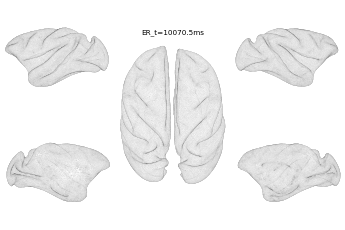

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:57: RuntimeWarning: invalid value encountered in greater


In [40]:
fig, ax = plt.subplots(ncols=5, nrows=10)
cmap = cm.Reds
cmap.set_under(color='w')
vmin_node=nostim_thr.abs().values.mean()
kws = {'edgecolors': 'k', 'vmin': vmin_node, 'cmap': cmap, #between 0.013 and 0.015 (0.014-0.015) #0.0145
'vmax': 1, 'alpha': None, 'linewidth': 0.01}

ts=[10000.5, 10010.5, 10070.5]

for t_it,t in enumerate(ts):
    data = np.append(df_notstim1.ix[t].abs().values, nan)
#     for node in range(len(nodes)): ##only gives one value for vmin, and therefore plotting function
#         vmin_node=vmin_thr[node]
    
    plot_surface_mpl_mv(vtx=vtx ,tri=tri,rm=rm,data=data, figsize=(10,10),
                    hemi=hemi ,shade_kwargs=kws) 
    plt.title(stim_name + '_t=%1.1fms' %t,fontsize=9)
    
    f = '/rri_disks/home/akacollja/tvb/brain_plots/braintmp_ER_t%1.1fms.png' %t
    plt.savefig(f,bbox_inches='tight', pad_inches=0, dpi=1200)

# **Make the plot**

We will be saving the figures then displaying them since these are a little big and have difficulties loading them on the spot. Expect at least a few minutes for the figures to load. Change the ts times to display the time frames you want to look at. 

In [40]:
cd '/rri_disks/home/akacollja/tvb/brain_plots'

/rri_disks/home/akacollja/tvb/brain_plots


<IPython.core.display.Javascript object>


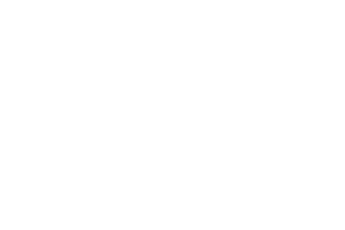

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:57: RuntimeWarning: invalid value encountered in greater


In [42]:
fig, ax = plt.subplots(ncols=5, nrows=10)
cmap = cm.Reds
cmap.set_under(color='W')

kws = {'edgecolors': 'k', 'vmin': -5, 'cmap': cmap, 
       'vmax': 18, 'alpha':None, 'linewidth': 0.01}

#ts=[10000.5, 10050.5, 10100.5, 10150.5, 10200.5, 10250.5, 10300.5, 10350.5, 10400.5, 10450.5]

#ts=[ 10000.5, 10045.5, 10350.5]

ts=[10000.5]

for t_it,t in enumerate(ts):

    dat = np.append(df_notstim.ix[t].abs().values, nan)
    #dat = np.append(df_tavg.ix[t].abs().values, nan)

    
    plot_surface_mpl_mv(vtx=vtx,tri=tri,rm=rm,data=dat, figsize=(10,10),
                    hemi=hemi ,shade_kwargs=kws) 
    
    plt.title(stim_name + '_t=%1.1fms' %t,fontsize=9)
    
    f = '/rri_disks/home/akacollja/tvb/brain_plots/braintmp_v1_t%1.1fms.png' %t
    plt.savefig(f,bbox_inches='tight', pad_inches=0, dpi=1200)
    plt.close()

<IPython.core.display.Javascript object>


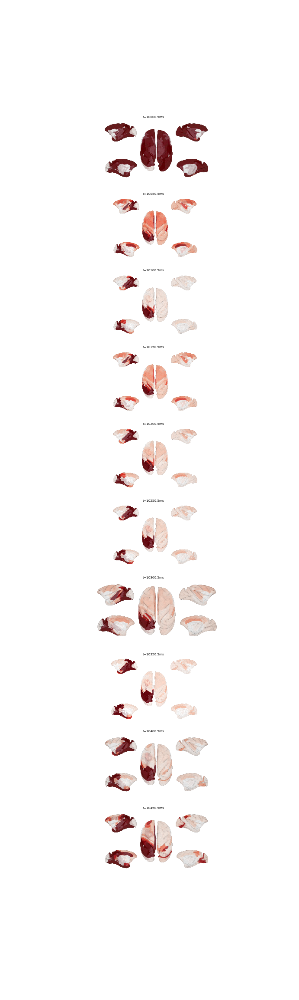

In [66]:
fig, ax = plt.subplots(nrows=10, figsize= (12,40))

for t_it,t in enumerate(ts):
    f =  '/rri_disks/home/akacollja/tvb/brain_plots/braintmp_v1_t%1.1fms.png' %t
    ax[t_it].imshow(plt.imread(f))
    ax[t_it].axis('off')
    ax[t_it].set_title('t=%1.1fms' %t,fontsize=9)

Next, we will be displaying figures at given eigen vector slices.

<IPython.core.display.Javascript object>


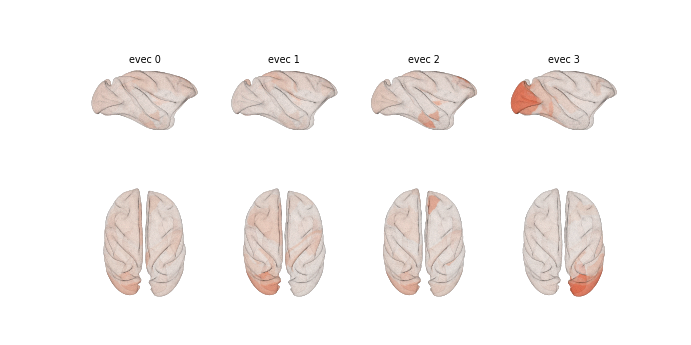

In [64]:
#display the data with one color

kws = {'edgecolors': 'k', 'vmin': 0, 'cmap': 'Reds', #'vmin': 0.4
       'vmax': 1, 'alpha': None, 'linewidth': 0.01}

fig, ax = plt.subplots(ncols=4,nrows=2,figsize=(12,6))

for e_it in range(4):
    dat = np.abs(dat_notrans_cov_evecs_155[:,e_it])

    plot_surface_mpl(vtx=vtx,tri=tri,data=dat,rm=rm,ax=ax[0][e_it],
                     shade_kwargs=kws,view='rh_lat', title='evec %s' %e_it)

    plot_surface_mpl(vtx=vtx,tri=tri,data=dat,rm=rm,ax=ax[1][e_it],
                     shade_kwargs=kws,view='superior')
    

---

# HC stimulation


Now repeat the process with the node you want to stimulate. 

In [1]:
pwd

u'/rri_disks/home/akacollja'

In [2]:
import sys
sys.path.append('/home/akacollja/tvb_scientific/tvb-library')
sys.path.append('/home/akacollja/tvb_scientific/tvb-data')

In [3]:
# In[3]:

import sys
nbso,nbse = sys.stdout,sys.stderr # hack part 1/2 to keep output printing properly

from tvb.simulator.lab import *
#LOG= get_logger('demo')
from tvb.simulator.plot.tools import *
import pandas as pd
import numpy as np

sys.stdout,sys.stderr = nbso,nbse  # ...hack part 2/2
#from tvb.simulator.plot.tools import plot_surface_mpl,plot_surface_mpl_mv

In [4]:
import os, sys, glob,h5py, itertools, multiprocessing
from datetime import datetime
from time import time
from scipy import optimize
from scipy.spatial import cKDTree

get_ipython().magic(u'matplotlib inline')
from matplotlib import pyplot as plt
from IPython.display import Image,display as d
import seaborn as sns

import nibabel as nib
from nilearn.plotting import plot_roi
from dipy.tracking.utils import apply_affine

In [5]:
%pylab nbagg
from tvb.simulator.lab import *
LOG= get_logger('demo')
from tvb.simulator.plot.tools import *

Populating the interactive namespace from numpy and matplotlib


/home/akacollja/miniconda/lib/python2.7/site-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['datetime', 'colors']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


These parameters are the same as the ones above. If you change the parameters in the V1 stimulation, remember to change them here as well.

In [6]:
new_conn= connectivity.Connectivity.from_file("newconn.zip")
new_conn.configure()
new_conn.weights= (np.loadtxt('/home/akacollja/Data/avg9/weights.txt'))
new_conn.tract_lengths= np.loadtxt('/home/akacollja/Data/avg9/tract_lengths.txt')

In [7]:
mod= models.Generic2dOscillator(d = (1/1000.) * 76.74,
                                tau =1., f= 1.,e= 0., g= -0.1, 
                            alpha =1., gamma= 1., c= 0., b= -12.3083, beta =0., a =0.)
heunint = integrators.HeunDeterministic(dt = 0.1) 
#integrators = integrators.HeunDeterministic(dt = 0.2)
#integrators = integrators.HeunStochastic(dt = 0.1, noise=noise.Additive(nsig=5e-15)) 
#integrators = integrators.HeunStochastic(dt = 0.1, noise=noise.Additive(nsig=0)) 
cpl = coupling.Linear(a=0.01198)
mons= monitors.TemporalAverage(period = 1.0)
new_conn.speed= 8.15

### Defining the weighting of the stimuli

Specify the name and node number of the node you want to stimulate .

In [235]:
stim_node= 57
stim_name= 'PrS'

Don't forget to change these values if you change them above.

In [236]:
weighting = numpy.zeros((154))
weighting [[stim_node]] = 0.03

#temporal profile
eqn_t = equations.PulseTrain()
eqn_t.parameters['onset'] = 10000
eqn_t.parameters['T'] = 5000.0
eqn_t.parameters['tau'] = 100.0

### Creating the stimulus

In [237]:
stimulus = patterns.StimuliRegion( temporal = eqn_t, 
                                  connectivity = new_conn, 
                                  weight = weighting)

stimulus.configure_space()
stimulus.configure_time(numpy.arange(0.,15000, 2**-4))

### Putting together the simulator

In [238]:
init = 0.1*np.ones(sim.good_history_shape) 

In [239]:
sim = simulator.Simulator(
        model = mod,
        connectivity = new_conn,
        coupling = cpl,
        integrator = heunint,
        monitors = mons,
        stimulus = stimulus, 
        simulation_length = 15000,
        ).configure()



sim.initial_conditions = init

sim.configure()


initial_conditions,"[[[[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]] [[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]]] [[[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]] [[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]]] [[[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]] [[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]]] ..., [[[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]] [[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]]] [[[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]] [[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]]] [[[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]] [[ 0.1] [ 0.1] [ 0.1] ..., [ 0.1] [ 0.1] [ 0.1]]]]"
coupling,"Linear(a=0.01198, b=0)"
stimulus,"StimuliRegion(bound=False, value=None)"
integrator,HeunDeterministic(dt=0.1)
surface,None
connectivity,"Connectivity(bound=False, value=None)"
conduction_speed,3.0
simulation_length,15000
model,"Generic2dOscillator(bound=False, value=None)"
monitors,"[TemporalAverage(bound=False, value=None)]"


In [240]:
(tavg_time, tavg_data), = sim.run()

In [215]:
lst_nodes = [i for i in range(154) if i != stim_node]
nostimnode=tavg_data[:, 0, lst_nodes, 0]

In [189]:
datas_raw= (nostimnode)
d_raw= (tavg_data[:, 0, stim_node, 0])
follow_raw=( tavg_data[:, 0, 19, 0],tavg_data[:, 0, 36, 0],tavg_data[:, 0, 8, 0],tavg_data[:, 0, 20, 0],
             tavg_data[:, 0, 1, 0],tavg_data[:, 0, 2, 0],tavg_data[:, 0, 3, 0],tavg_data[:, 0, 4, 0],
             tavg_data[:, 0, 5, 0], tavg_data[:, 0, 7, 0], tavg_data[:, 0, 9, 0],tavg_data[:, 0, 12, 0],
             tavg_data[:, 0, 40, 0],tavg_data[:, 0, 56, 0],tavg_data[:, 0, 66, 0],tavg_data[:, 0, 67, 0],
             tavg_data[:, 0, 22, 0],tavg_data[:, 0, 72, 0],tavg_data[:, 0, 69, 0],tavg_data[:, 0, 13, 0],
             tavg_data[:, 0, 14, 0],tavg_data[:, 0, 35, 0],tavg_data[:, 0, 61, 0],tavg_data[:, 0, 29, 0],
             tavg_data[:, 0, 30, 0], tavg_data[:, 0, 57, 0])
datas= np.squeeze(datas_raw)
d= np.squeeze(d_raw).T
follow = np.squeeze(follow_raw).T

<IPython.core.display.Javascript object>


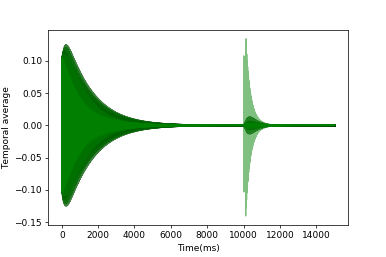

In [190]:
#time vs temporal average graph
figure()
plot(tavg_time, datas,'k', alpha = 0.5)
#plot(tavg_time, v1, 'r', alpha = 1)
plot(tavg_time, follow, 'g', alpha =0.5)
axes=plt.gca()
#axes.set_ylim([-0.15, 0.15])
ylabel("Temporal average")
xlabel ("Time(ms)")
plt.grid('off')

<IPython.core.display.Javascript object>


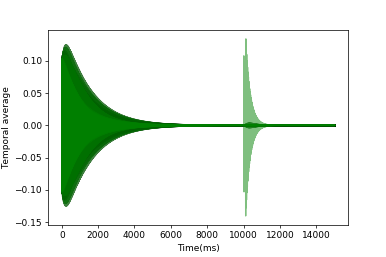

In [18]:
#time vs temporal average graph
figure()
plot(tavg_time, datas,'k', alpha = 0.5)
#plot(tavg_time, d, 'r', alpha = 1)
plot(tavg_time, follow, 'g', alpha =0.5)
ylabel("Temporal average")
xlabel ("Time(ms)")
plt.grid('off')

<IPython.core.display.Javascript object>


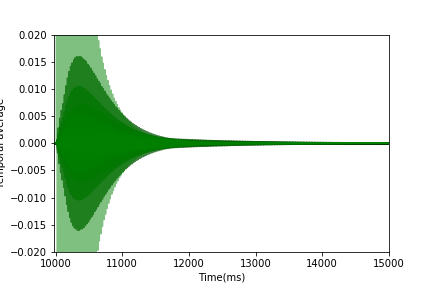

In [19]:
#time vs temporal average graph
figure()
plot(tavg_time, datas,'k', alpha = 0.5)
#plot(tavg_time, d, 'red', alpha = 1)
plot(tavg_time, follow, 'g', alpha =0.5)
axes=plt.gca()
axes.set_xlim([9975,15000]) #([9950,10700])
axes.set_ylim([-0.02, 0.02])
ylabel("Temporal average")
xlabel ("Time(ms)")
plt.grid('off')

#savefig('/home/akacollja/tvb/fig_dir/timeseries_V1scaled', bbox_inches='tight')

#savefig('/hestia/ryan_lab/byang/Byang/deterministic/timeseries_V1scaled.png', bbox_inches='tight')
#savefig('/home/byang/fig_dir/timeseries_V1scaled', bbox_inches='tight')


# #axes.get_xlim[10000,11000]
# 
# get_xlim(10000)

### Finding a threshold

In [241]:
time_notrans = tavg_time[range(9800,15000)]
data_notrans_mean= tavg_data.squeeze().T[:,range(9800, 10000)]
data_notrans= tavg_data.squeeze().T[:,range(9800, 15000)]

data_notrans_posthr= []
data_notrans_negthr= []
data_notrans_thr= []

for node in range(len(data_notrans_mean)):
    data_notrans_posthr.append(np.array(data_notrans[node]>(data_notrans_mean[node].max())))
    data_notrans_negthr.append(np.array(data_notrans[node]<(data_notrans_mean[node].min())))
    data_notrans_thr.append(np.array(data_notrans_posthr[node] + data_notrans_negthr[node]))

### Finding activation times

In [242]:
activation_time=np.array(np.zeros(len(data_notrans_thr)))
for node in range(len(data_notrans_thr)):
    for time in range(9800,15000):
        if np.array(data_notrans_thr[node][time -9800]) == True:
            activation_time[node]=time
            break
        else:
            activation_time[node]= nan
#activation_time

In [243]:
s = [stim_node,19,36,8,20,1,2,3,4,5,7,9,12,40,56,66,67,22,72,69,13,14,35,61,29,30,57, 50]
#nodes used by Heather s = [stim_node,36,69,72,22,13,14,40,66,8,19, 18,3,56,49,1,2,61,30,29,35]
#s = [stim_node,96,113,85,97,78,79,80,81,82,84,86,89,117,133,143,144,99,149,146,90,91,112,138,106,107]
activation_time_spec=np.array(np.zeros(len(s)))
i= 0
for node in s: 
    for time in range(9800,15000):
        if np.array(data_notrans_thr[node][time -9800]) == True:
            activation_time_spec[i]=time
            break
        else:
            activation_time_spec[i]= nan
    i += 1
activation_time_spec

array([ 10000.,  10024.,  10121.,  10097.,  10374.,  10097.,  10085.,
        10120.,  10095.,  10108.,  10014.,  10084.,  10120.,  10505.,
        10009.,  10005.,  10003.,  10469.,  10163.,  10080.,  10059.,
        10010.,  10047.,  10022.,  10022.,  10023.,  10000.,  10023.])

In [244]:
activation_times_spec=np.zeros(len(activation_time_spec))
for i in range(len(activation_time_spec)):
    if activation_time_spec[i] == 0 or activation_time_spec[i] < 10000:
        activation_times_spec[i]= nan
    else:
        activation_times_spec[i]= activation_time_spec[i] - 10000

Save the activation times externally for future use. 

In [245]:
cd '/rri_disks/home/akacollja/stim_data'

/rri_disks/home/akacollja/stim_data


In [246]:
file_name= stim_name + '_data.txt'
np.savetxt(file_name, activation_times_spec)

### Loading in region labels

In [19]:
import pandas as pd
pd.set_option('display.max_rows',200)
df_tavg = pd.DataFrame(np.squeeze(tavg_data),index=tavg_time)
labs= pd.read_csv('/home/htian/Data/kelly_matrix/labelnames.txt',sep='\t')['acronym'].values
lh_labs = [l + '_L' for l in labs]
rh_labs = [l + '_R' for l in labs]
region_labels_lr = np.concatenate([lh_labs, rh_labs])
df_tavg_labs = df_tavg.copy()
df_tavg_labs.columns= region_labels_lr

In [36]:
activation_times=np.zeros(len(activation_time))

for i in range(len(activation_time)):
    if activation_time[i] == 0 or activation_time[i] < 10000:
        activation_times[i]= nan
    else:
        activation_times[i]= activation_time[i] - 10000

### Bar graphs

In [28]:
lab_spec= np.array(['stim' ,'46', 'FEF', '24', '5', '10', '11', '12', '13', '14', '23', 
                    '25', '32', 'Ig', 'Pro', 'TF', 'TH', '7a', 'V4', 'V2', '35', '36', 
                    'ER', 'S', 'CA1', 'CA3'])

In [37]:
df_activation_spec= pd.DataFrame(activation_times, region_labels_lr) 
lst_nodes = [i for i in range(154) if i != stim_node]
labels_nostim=region_labels_lr[lst_nodes]

In [38]:
df_activation_spec_sort = df_activation_spec.sort_values(0)

<IPython.core.display.Javascript object>


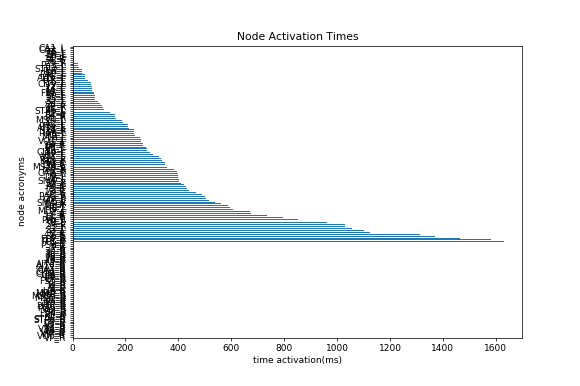

In [45]:
df_activation_spec_sort = df_activation_spec.sort_values(0)
ax = df_activation_spec_sort.plot(kind='barh', title="distances", figsize=(9,6), legend=False)
y_pos = np.arange(len(df_activation_spec_sort))
width= 0.05
rects = ax.barh(y_pos, df_activation_spec_sort, width)

ax.set_ylabel('node acronyms')
ax.set_xlabel('time activation(ms)')
ax.invert_yaxis()
ax.set_title('Node Activation Times')
ax.set_xlim(0,1700)


savefig ('/home/akacollja/activation', bbox_inches='tight')


### distances from stim

In [23]:
i =stim_node 
distances= np.array(np.zeros(len(new_conn.tract_lengths)))

for j in range(len(new_conn.tract_lengths)): 
    distances[j]= new_conn.tract_lengths[i, j]

In [24]:
df_distances= pd.DataFrame([labs, distances[:77]]).T
df_distances_labs= df_distances.sort_values(0)

<IPython.core.display.Javascript object>


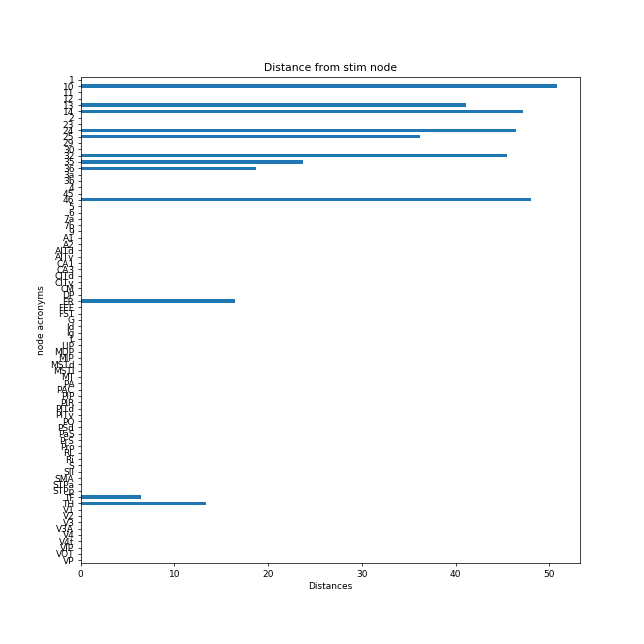

In [25]:
ax = df_distances_labs.plot(kind='barh', title="distances", figsize=(10,10), legend=False)
y_pos = np.arange(len(distances[:77])) 
width= 0. 
rects = ax.barh(y_pos,df_distances_labs[1], width) 
ax.set_ylabel('node acronyms') 
ax.set_xlabel('Distances')
ax.set_title('Distance from stim node') 
ax.invert_yaxis()
ax.set_yticks(range(len(labs))) 
ytickNames = ax.set_yticklabels(df_distances_labs[0])

### Finding amplitudes of each node

In [29]:
import pandas as pd

In [30]:
#no stim node in this data set 
data_nostim= nostimnode.T

max_amp= [] 
for node in range(len(data_nostim)): 
    max_amp.append(max(abs(data_nostim[node, range(9800,10000)])))

df_max_amp= pd.DataFrame(max_amp, labels_nostim) 
df_max_amp_sort= df_max_amp.sort_values(0) 

<IPython.core.display.Javascript object>


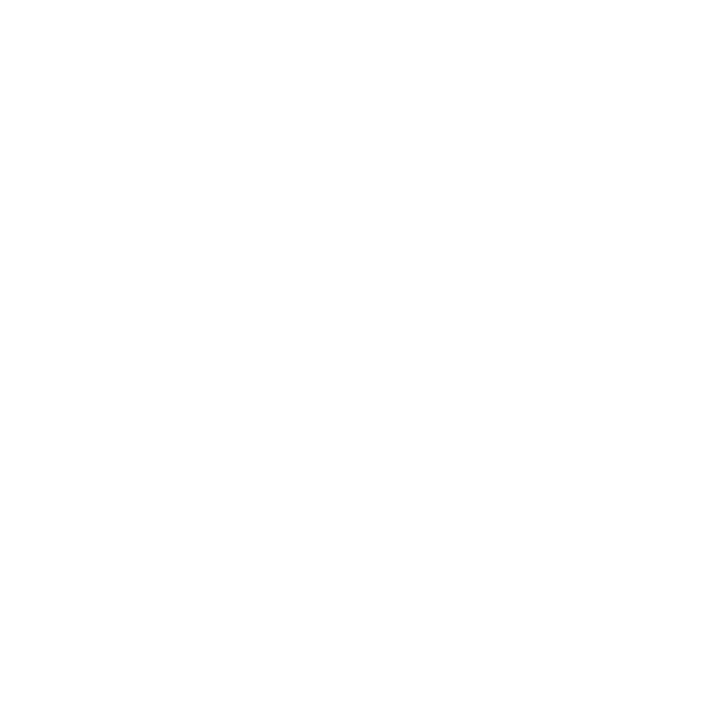

In [31]:
ax = df_max_amp_sort.plot(kind='barh', title="amplitudes", figsize=(10,10), legend=False) 
y_pos = np.arange(len(df_max_amp_sort)) 
width= 0. 
rects = ax.barh(y_pos, df_max_amp_sort, width)
ax.set_ylabel('node acronyms') 
ax.set_xlabel('amplitude') 
ax.invert_yaxis() 
ax.set_title('Amplitudes')

### Heat map

<IPython.core.display.Javascript object>


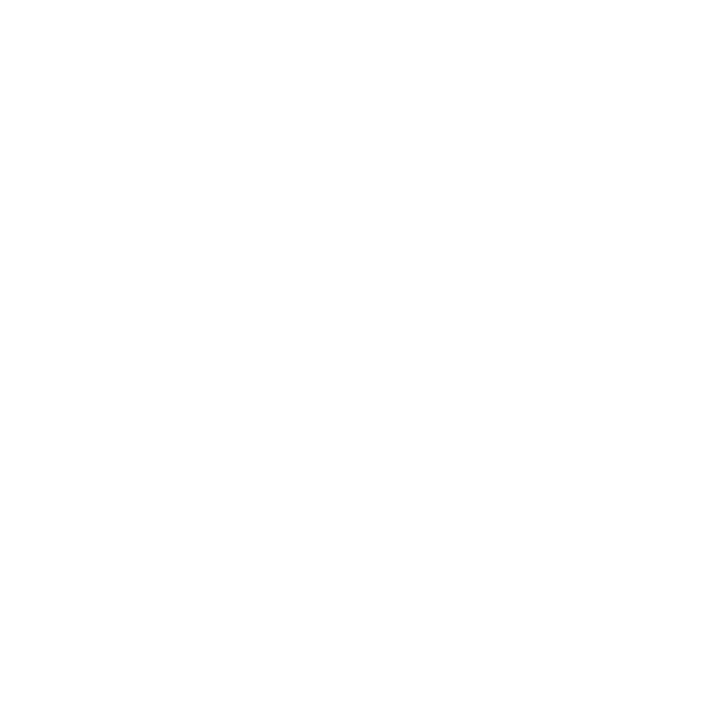

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  This is separate from the ipykernel package so we can avoid doing imports until
/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  after removing the cwd from sys.path.


In [32]:
import seaborn as sns 
fig, ax = plt.subplots(figsize = (10, 10)) 
sns.heatmap(df_tavg_labs.ix[9800:12000].T, ax=ax, vmin=-0.001, vmax=0.001, xticklabels='') 
ax.imshow(df_tavg.ix[9800:12000].T.values,vmin=-0.001, vmax=0.001, 
          aspect='auto',cmap='coolwarm', interpolation='none') 
ax.set_yticklabels 
ax.grid('off') 
for label in ax.get_yticklabels(): 
    label.set_rotation(0)

### Covariance Matrix

In [33]:
dat_raw= (nostimnode).T 
dat_notrans_prestim= np.squeeze(dat_raw)[:,range(9800, 10000)] 
dat_notrans_prestim.shape

lst_nodes = [i for i in range(154) if i != stim_node] 
labels_nostim=region_labels_lr[lst_nodes]

<IPython.core.display.Javascript object>


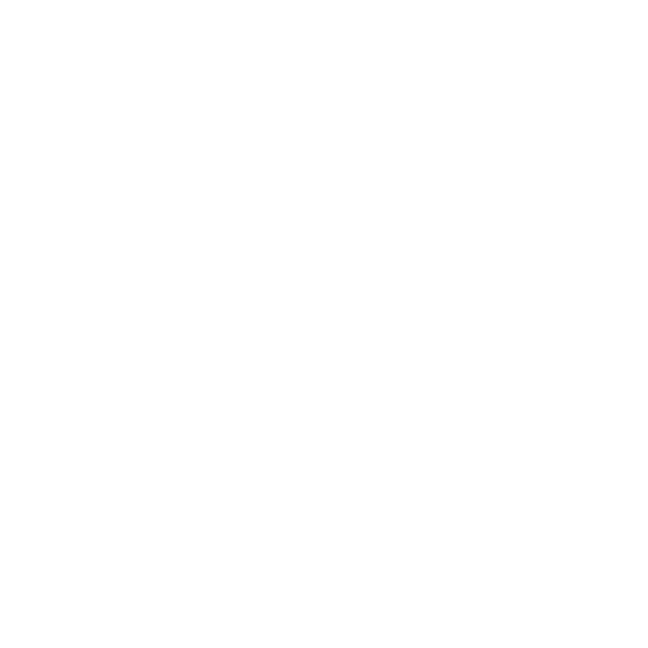

In [34]:
fig, ax= plt.subplots(figsize= (9,9)) 
fig.canvas.draw() 
ax.set_xticks(range(len(labels_nostim))) 
ax.set_yticks(range(len(labels_nostim))) 
ax.set_xticklabels(labels_nostim,rotation=90,fontsize=8) 
ax.set_yticklabels(labels_nostim, fontsize=8) 
plt.imshow(np.cov(dat_notrans_prestim), cmap= 'jet') 
plt.grid('off') 
plt.colorbar()

#savefig('/rri_disks/home/akacollja/')

### Eigen vector matrix

<IPython.core.display.Javascript object>


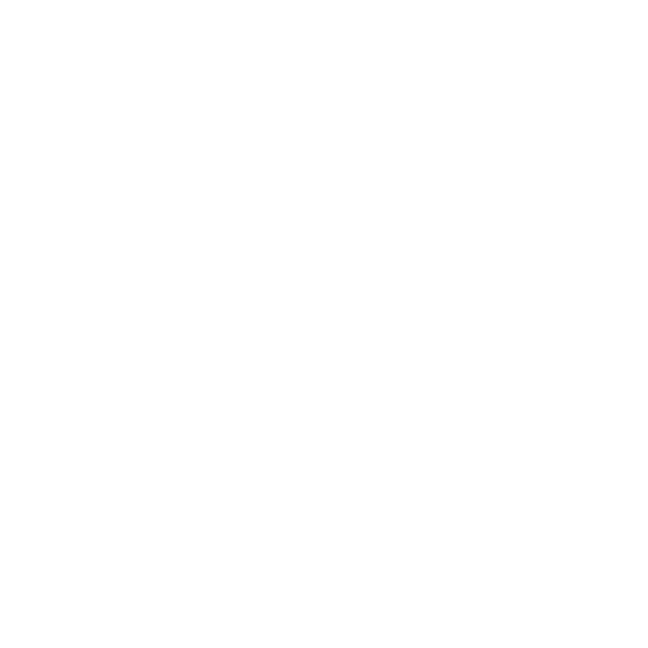

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:14: ComplexWarning: Casting complex values to real discards the imaginary part
  


In [35]:
from scipy.linalg import eig

dat_notrans_cov = np.cov(dat_notrans_prestim) 
dat_notrans_cov_evals, dat_notrans_cov_evecs = np.linalg.eig(dat_notrans_cov)
fig, ax =plt.subplots(figsize= (9,9)) 
fig.canvas.draw() 
ax.set_xticks(range(len(labels_nostim))) 
ax.set_yticks(range(len(labels_nostim))) 
ax.set_xticklabels(labels_nostim,rotation=90,fontsize=8) 
ax.set_yticklabels(labels_nostim, fontsize= 8)

#changed all 154 to 155 to take 0 into account 
dat_notrans_cov_evecs_155 = np.zeros([155,155]) 
dat_notrans_cov_evecs_155[:153,:153] = dat_notrans_cov_evecs 
plt.imshow(dat_notrans_cov_evecs_155, cmap= 'jet') 
plt.grid('off') 
plt.colorbar()

### Time slice on brain using surface plotting

In [25]:
from tvb.datatypes.cortex import Cortex
from tvb.datatypes.region_mapping import RegionMapping
from tvb.datatypes.projections import ProjectionMatrix
import pandas as pd
from matplotlib.tri import Triangulation
from numpy import pi, cos, sin
from matplotlib import cm

In [26]:
def plot_surface_mpl(vtx,tri,data=None,rm=None,reorient=None,view='superior',
                     shaded=False,ax=None,figsize=(6,4), title=None,
                     lthr=None,uthr=None, nz_thr = 1E-20,
                     shade_kwargs = {'edgecolors': 'k', 'linewidth': 0.1,
                                     'alpha': None, 'cmap': 'coolwarm',
                                     'vmin': None, 'vmax': None}):

    # in the namespace inadvertently. 
    vtx,tri = vtx.copy(),tri.copy()
    if data is not None: data = data.copy()

    # 1. Set the viewing angle 
  
    if reorient == 'tvb':
        # The tvb default brain has coordinates in the order 
        # yxz for some reason. So first change that:   
        vtx = np.array([vtx[:,1],vtx[:,0],vtx[:,2]]).T.copy()
        # Also need to reflect in the x axis
        vtx[:,0]*=-1

    # (reorient == 'fs' is same as reorient=None; so not strictly needed
    #  but is included for clarity)

    # ...get rotations for standard view options
    
    if   view == 'lh_lat'    : rots =  [(0,-90),(1,90)  ]
    elif view == 'lh_med'    : rots =  [(0,-90),(1,-90) ] 
    elif view == 'rh_lat'    : rots =  [(0,-90),(1,-90) ]
    elif view == 'rh_med'    : rots =  [(0,-90),(1,90)  ]
    elif view == 'superior'  : rots =   None
    elif view == 'inferior'  : rots =   (1,180)
    elif view == 'anterior'  : rots =   (0,-90)
    elif view == 'posterior' : rots =  [(0, -90),(1,180)]
    elif (type(view) == tuple) or (type(view) == list): rots = view 

    # (rh_lat is the default 'view' argument because no rotations are 
    #  for that one; so if no view is specified when the function is called, 
    #  the 'rh_lat' option is chose here and the surface is shown 'as is'                          
                            
    # ...apply rotations                          
    if rots is None: rotmat = np.eye(3)
    else:            rotmat = get_combined_rotation_matrix(rots)
    vtx = np.dot(vtx,rotmat)

    # 2. Sort out the data
                                    
    # ...if no data is given, plot a vector of 1s. 
    #    if using region data, create corresponding surface vector 
    if data is None: 
        data = np.ones(vtx.shape[0]) 
    elif data.shape[0] != vtx.shape[0]: 
        data = np.array([data[r] for r in rm])
    
    # ...apply thresholds
    if uthr: data *= (data < uthr)
    if lthr: data *= (data > lthr)
    data *= (np.abs(data) > nz_thr)

    # 3. Create the surface triangulation object 
    x,y,z = vtx.T
    tx,ty,tz = vtx[tri].mean(axis=1).T
    tr = Triangulation(x,y,tri[np.argsort(tz)])
                
    # 4. Make the figure 
    if ax is None: fig, ax = plt.subplots(figsize=figsize)  
  
    #if shade = 'gouraud': shade_opts['shade'] = 
    tc = ax.tripcolor(tr, np.squeeze(data), **shade_kwargs)
                        
    ax.set_aspect('equal')
    ax.axis('off')
    
    if title is not None: ax.set_title(title)

In [27]:
def plot_surface_mpl_mv(vtx=None,tri=None,data=None,rm=None,hemi=None,   # Option 1
                        vtx_lh=None,tri_lh=None,data_lh=None,rm_lh=None, # Option 2
                        vtx_rh=None,tri_rh=None,data_rh=None,rm_rh=None,
                        title=None,**kwargs):
 
    if vtx is not None:                                    # Option 1
        tri_hemi = hemi[tri].any(axis=1)
        tri_lh,tri_rh = tri[tri_hemi==0],tri[tri_hemi==1]
    elif vtx_lh is not None:                               # Option 2
        vtx = np.vstack([vtx_lh,vtx_rh])
        tri = np.vstack([tri_lh,tri_rh+tri_lh.max()+1])

    if data_lh is not None:                                # Option 2
        data = np.hstack([data_lh,data_rh])
    
    if rm_lh is not None:                                  # Option 2 
        rm = np.hstack([rm_lh,rm_rh + rm_lh.max() + 1])
    
 
    # 2. Now do the plots for each view

    # (Note: for the single hemispheres we only need lh/rh arrays for the 
    #  faces (tri); the full vertices, region mapping, and data arrays
    #  can be given as arguments, they just won't be shown if they aren't 
    #  connected by the faces in tri )
  
    # LH lateral
    plot_surface_mpl(vtx,tri_lh,data=data,rm=rm,view='lh_lat',
                   ax=subplot(2,3,1),**kwargs)
    
    # LH medial
    plot_surface_mpl(vtx,tri_lh, data=data,rm=rm,view='lh_med',
                   ax=subplot(2,3,4),**kwargs)
    
    # RH lateral
    plot_surface_mpl(vtx,tri_rh, data=data,rm=rm,view='rh_lat',
                   ax=subplot(2,3,3),**kwargs)
    
    # RH medial
    plot_surface_mpl(vtx,tri_rh, data=data,rm=rm,view='rh_med',
                   ax=subplot(2,3,6),**kwargs)
    
    # Both superior
    plot_surface_mpl(vtx,tri, data=data,rm=rm,view='superior',
                   ax=subplot(1,3,2),title=title,**kwargs)
    
    plt.subplots_adjust(left=0.0, right=1.0, bottom=0.0,
                      top=1.0, wspace=0, hspace=0) 

In [28]:
def get_combined_rotation_matrix(rotations):
    rotmat = np.eye(3)
    
    if type(rotations) is tuple: rotations = [rotations] 
    for r in rotations:
        newrot = get_rotation_matrix(r[0],r[1])
        rotmat = np.dot(rotmat,newrot)
    return rotmat

In [29]:
def get_rotation_matrix(rotation_axis, deg):
    # (note make deg minus to change from anticlockwise to clockwise rotation)
    th = -deg * (pi/180) # convert degrees to radians
    
    if rotation_axis == 0:
        return np.array( [[    1,         0,         0    ],
                          [    0,      cos(th),   -sin(th)],
                          [    0,      sin(th),    cos(th)]])
    elif rotation_axis ==1:
        return np.array( [[   cos(th),    0,        sin(th)],
                          [    0,         1,          0    ],
                          [  -sin(th),    0,        cos(th)]])
    elif rotation_axis ==2:
        return np.array([[   cos(th),  -sin(th),     0    ],
                         [    sin(th),   cos(th),     0   ],
                         [     0,         0,          1   ]])

### Make fig

In [44]:
ctx_file= '/home/htian/Data/newzip.zip'
rm= np.loadtxt('/home/htian/Data/region_mapping.txt')
hemi= np.loadtxt('/home/htian/Data/fv91_srfData_20170215/hemispheres.txt')

In [30]:
ctx_file ='/home/htian/Data/newzip.zip'
rm= np.loadtxt('/home/htian/Data/region_mapping.txt').astype(int)
hemi= np.loadtxt('/home/htian/Data/fv91_srfData_20170215/hemispheres.txt').astype(int)

In [31]:
ctx = cortex.Cortex.from_file(source_file = ctx_file)
vtx,tri = ctx.vertices,ctx.triangles

df_tavg = pd.DataFrame(np.squeeze(tavg_data),index=tavg_time)
df_tavg

,0,1,2,3,4,5,6,7,8,9,...,144,145,146,147,148,149,150,151,152,153
10.5,7.160086e-02,7.162343e-02,7.156362e-02,7.153975e-02,7.158882e-02,7.159134e-02,7.161539e-02,7.162460e-02,7.173846e-02,7.152039e-02,...,7.152560e-02,7.156494e-02,7.177374e-02,7.156541e-02,7.155317e-02,7.168912e-02,7.150986e-02,7.148597e-02,7.154663e-02,7.154432e-02
11.5,1.033323e-01,1.034272e-01,1.031672e-01,1.030618e-01,1.032781e-01,1.032903e-01,1.033943e-01,1.034314e-01,1.039277e-01,1.029781e-01,...,1.030002e-01,1.031747e-01,1.040857e-01,1.031741e-01,1.031198e-01,1.037146e-01,1.029324e-01,1.028260e-01,1.030957e-01,1.030829e-01
12.5,9.788900e-02,9.805303e-02,9.760704e-02,9.742213e-02,9.779985e-02,9.781915e-02,9.799764e-02,9.805684e-02,9.890669e-02,9.727964e-02,...,9.731685e-02,9.761842e-02,9.918777e-02,9.761801e-02,9.752214e-02,9.855062e-02,9.720077e-02,9.701448e-02,9.748140e-02,9.746242e-02
13.5,8.546454e-02,8.569927e-02,8.509405e-02,8.484871e-02,8.534905e-02,8.537114e-02,8.561702e-02,8.570676e-02,8.685717e-02,8.465391e-02,...,8.470495e-02,8.510574e-02,8.722069e-02,8.511302e-02,8.498797e-02,8.636745e-02,8.454624e-02,8.430471e-02,8.491069e-02,8.490099e-02
14.5,6.697053e-02,6.727569e-02,6.654705e-02,6.627581e-02,6.683479e-02,6.685779e-02,6.715697e-02,6.729828e-02,6.867844e-02,6.603901e-02,...,6.610019e-02,6.656177e-02,6.904098e-02,6.658148e-02,6.644712e-02,6.804415e-02,6.591365e-02,6.564934e-02,6.630929e-02,6.632927e-02
15.5,4.373098e-02,4.409885e-02,4.330124e-02,4.304677e-02,4.358511e-02,4.360815e-02,4.393624e-02,4.415463e-02,4.565718e-02,4.278439e-02,...,4.285127e-02,4.332246e-02,4.591867e-02,4.335685e-02,4.323500e-02,4.487086e-02,4.265642e-02,4.240757e-02,4.302107e-02,4.308822e-02
16.5,1.740034e-02,1.781265e-02,1.701833e-02,1.682587e-02,1.725807e-02,1.728046e-02,1.760439e-02,1.791991e-02,1.939818e-02,1.656056e-02,...,1.662788e-02,1.704808e-02,1.946741e-02,1.709749e-02,1.700997e-02,1.847695e-02,1.644691e-02,1.625410e-02,1.671694e-02,1.684190e-02
17.5,-1.014631e-02,-9.719378e-03,-1.042490e-02,-1.051328e-02,-1.026897e-02,-1.024848e-02,-9.966971e-03,-9.548613e-03,-8.266640e-03,-1.075387e-02,...,-1.069231e-02,-1.038641e-02,-8.458600e-03,-1.032390e-02,-1.035751e-02,-9.274767e-03,-1.083606e-02,-1.093452e-02,-1.071849e-02,-1.053406e-02
18.5,-3.694161e-02,-3.653986e-02,-3.706545e-02,-3.701590e-02,-3.702794e-02,-3.701107e-02,-3.681155e-02,-3.630352e-02,-3.539712e-02,-3.720189e-02,...,-3.715263e-02,-3.702000e-02,-3.588716e-02,-3.694855e-02,-3.691327e-02,-3.641411e-02,-3.723707e-02,-3.720977e-02,-3.731697e-02,-3.708137e-02
19.5,-6.106577e-02,-6.073565e-02,-6.099395e-02,-6.078557e-02,-6.110018e-02,-6.108897e-02,-6.100809e-02,-6.044294e-02,-6.007919e-02,-6.088784e-02,...,-6.085709e-02,-6.094529e-02,-6.086563e-02,-6.087102e-02,-6.075851e-02,-6.100263e-02,-6.086380e-02,-6.069044e-02,-6.116733e-02,-6.089868e-02


In [32]:
rm.shape

(70078,)

In [48]:
isrh_vtx = np.array([isrh_reg[r] for r in rm])

NameError: name 'isrh_reg' is not defined

In [44]:
#df_tavg.max()

In [33]:
notstim= np.squeeze(tavg_data).copy()
notstim[:, stim_node]= 0
           
m = np.array([(np.abs(notstim[i])).max() for i in range(len(notstim))])
for i in range(len(notstim)):
    for j in range(len(notstim[1])):
        #print i,
        notstim[i,j] /= m[i]

df_notstim = pd.DataFrame(notstim,index=tavg_time)

In [46]:
vmin_node=df_notstim.ix[t].abs().values.mean()

In [504]:
cd '/rri_disks/home/akacollja/tvb/brain_plots/'

/rri_disks/home/akacollja/tvb/brain_plots


<IPython.core.display.Javascript object>


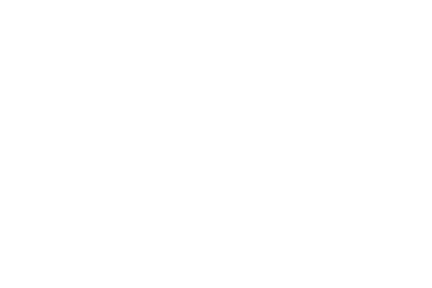

/rri_disks/home/akacollja/miniconda/lib/python2.7/site-packages/ipykernel_launcher.py:57: RuntimeWarning: invalid value encountered in greater


<IPython.core.display.Javascript object>


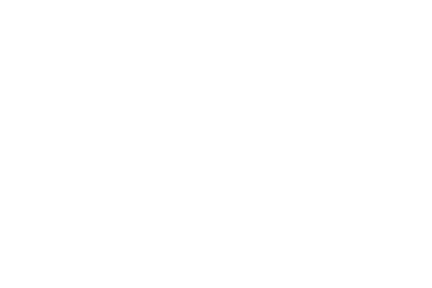

<IPython.core.display.Javascript object>


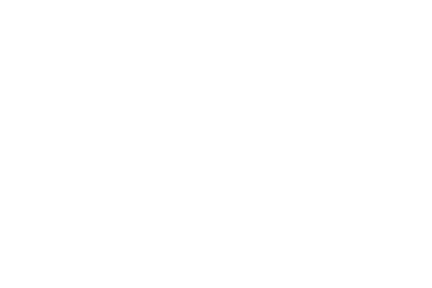

In [47]:
fig, ax = plt.subplots(ncols=1, nrows=10)
cmap = cm.Reds
cmap.set_under(color='w')

kws = {'edgecolors': 'k', 'vmin': vmin_node, 'cmap': cmap, 
       'vmax': 1 , 'alpha': None, 'linewidth': 0.01}


ts=[10000.5, 10059.5, 10121.5]#, 10150.5, 10200.5, 10250.5, 10300.5, 100.5, 10400.5, 10450.5]
#ts=[10000.5, 10035.5, 10105.5, 10175.5, 10245.5, 10350.5, 10525.5, 10700.5, 10875.5, 11050.5, 11225.5, 11400.5, 11575.5]

for t_it,t in enumerate(ts):
    data = np.append(df_notstim.ix[t].abs().values, nan)
 
    plot_surface_mpl_mv(vtx=vtx,tri=tri,rm=rm,data=data, figsize=(10,10),
                    hemi=hemi ,shade_kwargs=kws) 
    
    f = '/rri_disks/home/akacollja/tvb/brain_plots/braintmp_' + stim_name +'_t%1.1fms.png' %t
    plt.savefig(f,bbox_inches='tight')
    plt.close()
    #plt.show()

<IPython.core.display.Javascript object>


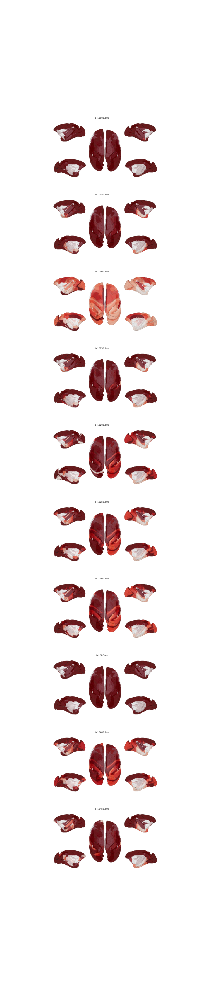

In [50]:
fig, ax = plt.subplots(nrows=10, figsize= (12,60))
for t_it,t in enumerate(ts):
    f =  '/rri_disks/home/akacollja/tvb/brain_plots/braintmp_' + stim_name + '_t%1.1fms.png' %t
    ax[t_it].imshow(plt.imread(f))
    ax[t_it].axis('off')
    ax[t_it].set_title('t=%1.1fms' %t,fontsize=9)


### Plotting eigenvector on brain

<IPython.core.display.Javascript object>


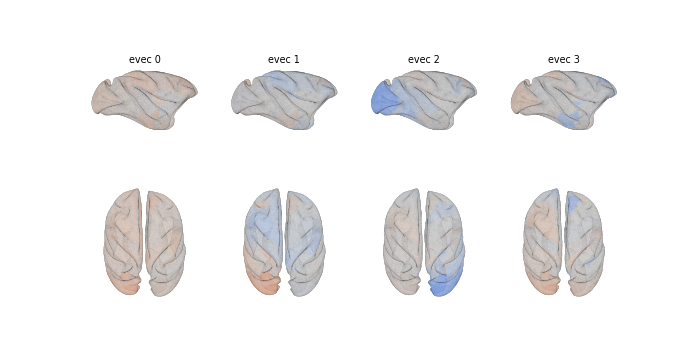

In [51]:
#display the data
kws = {'edgecolors': 'k', 'vmin': -1, 'cmap': 'coolwarm', 'vmax': 1, 'alpha': None, 'linewidth': 0.01}
fig, ax = plt.subplots(ncols=4,nrows=2,figsize=(12,6))
for e_it in range(4): 
    dat = dat_notrans_cov_evecs_155[:,e_it]
    
    plot_surface_mpl(vtx=vtx,tri=tri,data=dat,rm=rm,ax=ax[0][e_it],
                 shade_kwargs=kws,view='rh_lat', title='evec %s' %e_it)
    
    plot_surface_mpl(vtx=vtx,tri=tri,data=dat,rm=rm,ax=ax[1][e_it],
                 shade_kwargs=kws,view='superior')

<IPython.core.display.Javascript object>


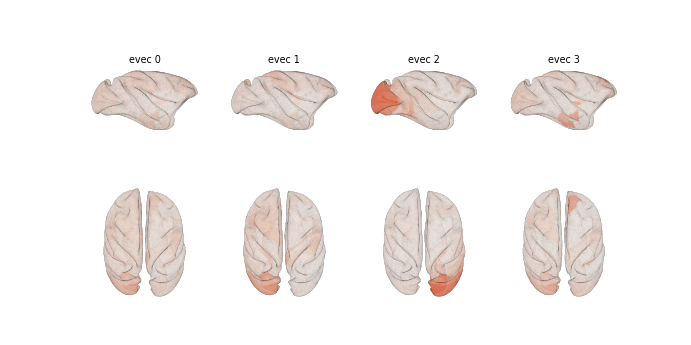

In [52]:
#display the data with one color

kws = {'edgecolors': 'k', 'vmin': 0, 'cmap': 'Reds', #'vmin': 0.4
       'vmax': 1, 'alpha': None, 'linewidth': 0.01}

fig, ax = plt.subplots(ncols=4,nrows=2,figsize=(12,6))

for e_it in range(4):
    dat = np.abs(dat_notrans_cov_evecs_155[:,e_it])

    plot_surface_mpl(vtx=vtx,tri=tri,data=dat,rm=rm,ax=ax[0][e_it],
                     shade_kwargs=kws,view='rh_lat', title='evec %s' %e_it)

    plot_surface_mpl(vtx=vtx,tri=tri,data=dat,rm=rm,ax=ax[1][e_it],
                     shade_kwargs=kws,view='superior')

---

### all activation times

After running all the stimulations you wanted, load in all your files that you saved previously. Here, we will be saving all the activation times in a dataframe to compare activation times of all stimulations.

In [ ]:
import pandas as pd
act_times= []
act_times.append(np.array(np.loadtxt('S_data.txt')))
act_times.append(np.array(np.loadtxt('CA3_data.txt')))
act_times.append(np.array(np.loadtxt('CA1_data.txt')))
act_times.append(np.array(np.loadtxt('ER_data.txt')))
act_times= np.array(act_times)


In [ ]:
col_labs= ['S','CA3', 'CA1', 'ER']

In [ ]:
df_activation_spec_all = pd.DataFrame(act_times.T,lab_spec, columns= col_labs) 
df_activation_spec_all

Here we visualizing the data with a bar graph.

In [ ]:
ax= df_activation_spec_all.plot(kind='barh', title='Activation times', figsize=(10,10))

ax.set_ylabel('node acronyms')
ax.set_xlabel('time activation(ms)')
ax.invert_yaxis()
ax.set_title('Node Activation Times')
ax.set_xlim(0,2000)